In [2]:
import pandas as pd
import scanpy as sc
import numpy as np
import sys
import matplotlib.pyplot as plt
from tqdm import tqdm
import seaborn as sns
import process_functions as pf
sys.path.insert(1, '/cndd3/dburrows/CODE/admin_tools/')
from admin_tools import admin_functions as adm

%load_ext autoreload

#PATHS
data_path = '/datasets/Public_Datasets/KIBM_Spitzer_NeurotransmitterSwitching/'
out_path = '/cndd3/dburrows/DATA/neurotransmitter_switch/processed/3batch/'
eran_path = '/cndd/emukamel/KIBM_neuroswitch/Analyze_3batches/'

# Load data

In [3]:
#Load raw grouped data
#adata_raw=sc.read_h5ad(data_path + 'KIBM_adata_raw_cellbender.h5ad')
adata = sc.read_h5ad(out_path + 'KIBM_adata_mapmycells.h5ad')
#fdata = sc.read_h5ad(out_path + 'KIBM_adata_processed-filtered.h5ad')
#subdata = sc.read_h5ad(out_path + 'KIBM_adata_processed-filtered-subset.h5ad')

In [6]:
#generate null distribution
adata.X[0,0]

61

# Process data

In [130]:
#group batches together
samples=['JD_47_1_2','JD_48_1_2','JD_52_1_2','JD_53_1_2','JD_58_1_2','JD_59_1_2']
samplesheet=pd.read_csv(data_path+'/Spitzer-HT-RNA-Batch-2.csv',index_col='LibID')
samplesheet=pd.concat((samplesheet,pd.read_csv(data_path + '/Spitzer-HT-RNA-Batch-1.csv',index_col='LibID')))
samplesheet=pd.concat((samplesheet,pd.read_csv(data_path + '/Spitzer-HT-RNA-Batch-3.csv',index_col='LibID')))
samplesheet=samplesheet.sort_index()
samplesheet=samplesheet[~samplesheet.index.duplicated()]
#Process data to give correct labels for each sample
adatas=[]
genes=pd.read_csv('/cndd/emukamel/KIBM_neuroswitch/KIBM_Spitzer_NeurotransmitterSwitching/counts/JD_52_1_2/outs/raw_feature_bc_matrix/features.tsv.gz',
                  sep='\t',index_col=0,names=['ensid','gene','genetype'])
for libid in tqdm(samples):
    libid_base = libid.replace('_1_2','')
    # ad=sc.read_10x_h5(f'KIBM_Spitzer_NeurotransmitterSwitching/counts/{libid}/outs/filtered_feature_bc_matrix.h5')
    ad=sc.read_10x_h5(data_path + f'/cellbender/{libid_base}/{libid}_cellbender_filtered.h5')
    assert (ad.var_names==genes['gene']).all()
    ad.var=genes
    print(ad.shape)

    ad.obs.index=ad.obs.index+'-'+libid
    ad.obs['LibID']=libid
    ad.obs['Sample']=samplesheet.loc[libid,'Sample']
    adatas.append(ad)


#Group together, order and filter
adata=sc.concat(adatas,axis=0)
adata.obs_names_make_unique()
adata.var=adata.var.join(genes)
adata.obs['Sample']=adata.obs['Sample'].astype(pd.CategoricalDtype(['Sal 1','Sal 2','Sal 3','PCP 1','PCP 2','PCP 3'],ordered=True))


  0%|                                                                                                  | 0/6 [00:00<?, ?it/s]/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
 17%|███████████████                                                                           | 1/6 [00:01<00:09,  1.84s/it]

(22762, 31053)


/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
 33%|██████████████████████████████                                                            | 2/6 [00:03<00:07,  1.98s/it]

(26894, 31053)


/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
 50%|█████████████████████████████████████████████                                             | 3/6 [00:05<00:05,  1.79s/it]

(23661, 31053)


/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
 67%|████████████████████████████████████████████████████████████                              | 4/6 [00:07<00:03,  1.75s/it]

(19842, 31053)


/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
 83%|███████████████████████████████████████████████████████████████████████████               | 5/6 [00:09<00:01,  1.84s/it]

(23684, 31053)


/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/dburrows/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
100%|██████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:11<00:00,  1.86s/it]


(22459, 31053)


In [131]:
adata

AnnData object with n_obs × n_vars = 139302 × 31053
    obs: 'LibID', 'Sample'
    var: 'gene', 'genetype'

In [132]:
#RAW FILT
#Filter cells -> revisit this! 
sc.pp.filter_genes(adata, min_counts=100)
sc.pp.filter_cells(adata,min_genes=50)
sc.pp.filter_cells(adata, min_counts=500)
sc.pp.filter_genes(adata,min_cells=10)

In [133]:
adata

AnnData object with n_obs × n_vars = 115711 × 19483
    obs: 'LibID', 'Sample', 'n_genes', 'n_counts'
    var: 'gene', 'genetype', 'n_counts', 'n_cells'

Text(0.5, 0, 'UMI counts')

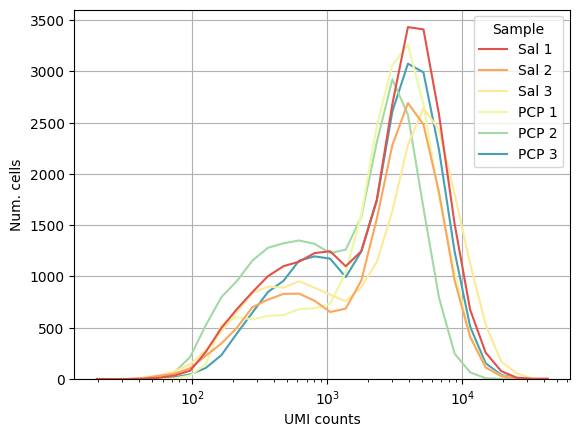

In [55]:
ax=sns.histplot(adata.obs,x='n_counts',hue='Sample',log_scale=True,fill=False,
                element='poly',bins=30,
                # stat='density',
                common_norm=False,
               palette='Spectral')
ax.grid(True)
ax.set_ylabel('Num. cells')
ax.set_xlabel('UMI counts')

Text(0.5, 0, 'UMI counts')

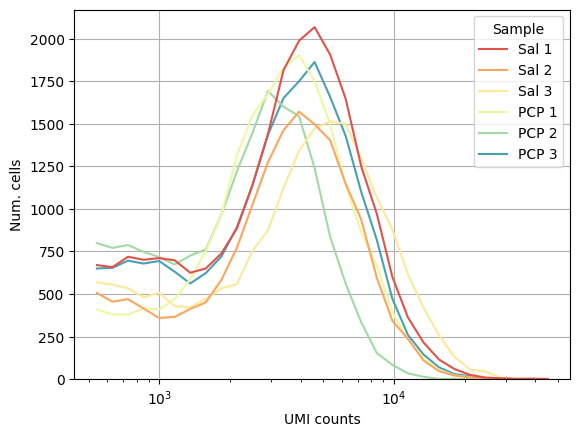

In [57]:
ax=sns.histplot(adata.obs,x='n_counts',hue='Sample',log_scale=True,fill=False,
                element='poly',bins=30,
                # stat='density',
                common_norm=False,
               palette='Spectral')
ax.grid(True)
ax.set_ylabel('Num. cells')
ax.set_xlabel('UMI counts')

In [134]:
# SAVE RAW adata that can be used for MapMyCells
adata.write_h5ad(out_path + 'KIBM_adata_raw_cellbender.h5ad')

In [59]:
#write by batch for MMC
for batch in [1,2,3]:
    adata[adata.obs['Sample'].str.endswith(f'{batch}')].write_h5ad(f'{outpath}KIBM_adata_raw_cellbender.batch{batch}.h5ad')
    print(adata[adata.obs['Sample'].str.endswith(f'{batch}')].shape)

(42478, 19483)
(34179, 19483)
(39054, 19483)


In [ ]:
# np.log(adata_raw[:,'Malat1'].X.median()+1)
adata_raw[adata.obs.index,'Malat1'].X.max()

# Run MapMyCells
https://knowledge.brain-map.org/mapmycells/process/

In [135]:
adata_raw=sc.read_h5ad(out_path + 'KIBM_adata_raw_cellbender.h5ad')

In [73]:
adata_raw

AnnData object with n_obs × n_vars = 115711 × 19483
    obs: 'LibID', 'Sample', 'n_genes', 'n_counts'
    var: 'gene', 'genetype', 'n_counts', 'n_cells'

In [136]:
from glob import glob
annots=glob(eran_path + 'MapMyCells/KIBM_adata_raw_cellbenderbatch*.csv')
dfs=[]
for annot in annots:
    dfs.append(pd.read_csv(annot,comment='#'))
mapped=pd.concat(dfs)

In [137]:
mapped

,cell_id,class_label,class_name,class_bootstrapping_probability,subclass_label,subclass_name,subclass_bootstrapping_probability,supertype_label,supertype_name,supertype_bootstrapping_probability,cluster_label,cluster_name,cluster_alias,cluster_bootstrapping_probability
0,ATCACAGTCCATTGCC-1-JD_52_1_2,CS20230722_CLAS_01,01 IT-ET Glut,1.00,CS20230722_SUBC_006,006 L4/5 IT CTX Glut,0.99,CS20230722_SUPT_0026,0026 L4/5 IT CTX Glut_4,0.98,CS20230722_CLUS_0091,0091 L4/5 IT CTX Glut_4,181,0.98
1,AAACGCTCATCGCCTT-1-JD_52_1_2,CS20230722_CLAS_01,01 IT-ET Glut,1.00,CS20230722_SUBC_007,007 L2/3 IT CTX Glut,0.93,CS20230722_SUPT_0030,0030 L2/3 IT CTX Glut_2,0.90,CS20230722_CLUS_0112,0112 L2/3 IT CTX Glut_2,236,0.90
2,AATTCCTGTTATGTGC-1-JD_52_1_2,CS20230722_CLAS_01,01 IT-ET Glut,0.97,CS20230722_SUBC_005,005 L5 IT CTX Glut,0.79,CS20230722_SUPT_0020,0020 L5 IT CTX Glut_3,0.62,CS20230722_CLUS_0061,0061 L5 IT CTX Glut_3,192,0.62
3,CTAGGTATCCTATTGT-1-JD_52_1_2,CS20230722_CLAS_01,01 IT-ET Glut,1.00,CS20230722_SUBC_022,022 L5 ET CTX Glut,1.00,CS20230722_SUPT_0090,0090 L5 ET CTX Glut_1,0.90,CS20230722_CLUS_0352,0352 L5 ET CTX Glut_1,387,0.90
4,TCCCACACAACGATTC-1-JD_52_1_2,CS20230722_CLAS_01,01 IT-ET Glut,1.00,CS20230722_SUBC_006,006 L4/5 IT CTX Glut,0.98,CS20230722_SUPT_0023,0023 L4/5 IT CTX Glut_1,1.00,CS20230722_CLUS_0069,0069 L4/5 IT CTX Glut_1,174,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42473,CTTGAGAGTGTGGACA-1-JD_48_1_2,CS20230722_CLAS_30,30 Astro-Epen,1.00,CS20230722_SUBC_319,319 Astro-TE NN,1.00,CS20230722_SUPT_1163,1163 Astro-TE NN_3,0.70,CS20230722_CLUS_5226,5226 Astro-TE NN_3,14945,0.70
42474,CACTTCGTCAAAGCCT-1-JD_48_1_2,CS20230722_CLAS_31,31 OPC-Oligo,1.00,CS20230722_SUBC_327,327 Oligo NN,1.00,CS20230722_SUPT_1184,1184 MOL NN_4,0.61,CS20230722_CLUS_5284,5284 MOL NN_4,5230,0.61
42475,ACGATCATCAGGAAAT-1-JD_48_1_2,CS20230722_CLAS_31,31 OPC-Oligo,1.00,CS20230722_SUBC_327,327 Oligo NN,1.00,CS20230722_SUPT_1184,1184 MOL NN_4,1.00,CS20230722_CLUS_5285,5285 MOL NN_4,5231,1.00
42476,TTACAGGCAGTTAGAA-1-JD_48_1_2,CS20230722_CLAS_31,31 OPC-Oligo,1.00,CS20230722_SUBC_327,327 Oligo NN,1.00,CS20230722_SUPT_1184,1184 MOL NN_4,1.00,CS20230722_CLUS_5285,5285 MOL NN_4,5231,1.00


In [140]:
# Append MMC to adata
if 'class_name' in adata.obs.columns:
    adata.obs=adata.obs.drop(columns=['class_name','subclass_name','supertype_name','cluster_name'])

adata.obs=adata.obs.join(mapped[['cell_id','class_name','subclass_name','supertype_name','cluster_name']].set_index('cell_id'))

In [142]:
adata.obs

,LibID,Sample,n_genes,n_counts,class_name,subclass_name,supertype_name,cluster_name
ATTCTACCAGCCTTCT-1-JD_47_1_2,JD_47_1_2,PCP 1,6427,33119,02 NP-CT-L6b Glut,030 L6 CT CTX Glut,0115 L6 CT CTX Glut_2,0441 L6 CT CTX Glut_2
ACCGTTCTCTTCTGGC-1-JD_47_1_2,JD_47_1_2,PCP 1,5700,31430,01 IT-ET Glut,022 L5 ET CTX Glut,0090 L5 ET CTX Glut_1,0353 L5 ET CTX Glut_1
CCTCACAGTCAGACTT-1-JD_47_1_2,JD_47_1_2,PCP 1,5317,27838,01 IT-ET Glut,022 L5 ET CTX Glut,0090 L5 ET CTX Glut_1,0352 L5 ET CTX Glut_1
CCACACTGTTCCCACT-1-JD_47_1_2,JD_47_1_2,PCP 1,5547,27088,02 NP-CT-L6b Glut,030 L6 CT CTX Glut,0115 L6 CT CTX Glut_2,0441 L6 CT CTX Glut_2
TACCTCGTCCCTATTA-1-JD_47_1_2,JD_47_1_2,PCP 1,5133,26574,01 IT-ET Glut,005 L5 IT CTX Glut,0018 L5 IT CTX Glut_1,0056 L5 IT CTX Glut_1
...,...,...,...,...,...,...,...,...
CTATAGGCAGGTTCAT-1-JD_59_1_2,JD_59_1_2,Sal 3,425,508,34 Immune,334 Microglia NN,1194 Microglia NN_1,5312 Microglia NN_1
ACTTAGGCACCCTATC-1-JD_59_1_2,JD_59_1_2,Sal 3,323,504,31 OPC-Oligo,327 Oligo NN,1184 MOL NN_4,5285 MOL NN_4
GGTGGCTCAAGCTACT-1-JD_59_1_2,JD_59_1_2,Sal 3,409,502,34 Immune,334 Microglia NN,1194 Microglia NN_1,5312 Microglia NN_1
TACGGTACACATCCCT-1-JD_59_1_2,JD_59_1_2,Sal 3,381,500,34 Immune,334 Microglia NN,1194 Microglia NN_1,5312 Microglia NN_1


In [146]:
# Remove glia and unlabeled cells
adata.obs['is_ctx_neuron']=(adata.obs['class_name'].str.contains(r'(Glut|GABA)$',regex=True))
adata.obs['is_ctx_neuron']=adata.obs['is_ctx_neuron']&(~adata.obs['subclass_name'].str.contains(r'STR',regex=True).astype(bool))
adata.obs['is_ctx_neuron'].value_counts()

/tmp/ipykernel_2759161/2475205709.py:2: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  adata.obs['is_ctx_neuron']=(adata.obs['class_name'].str.contains(r'(Glut|GABA)$',regex=True))


is_ctx_neuron
True     93544
False    22167
Name: count, dtype: int64

In [149]:
#save combined outputs
adata.write_h5ad(f'{out_path}KIBM_adata_mapmycells.h5ad')

# QC + process


In [1129]:
#Load raw grouped data
adata = sc.read_h5ad(out_path + 'KIBM_adata_mapmycells.h5ad')

#Calculate QC metrics
adata.var["mt"] = adata.var['gene'].str.startswith("mt-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True, log1p=True)

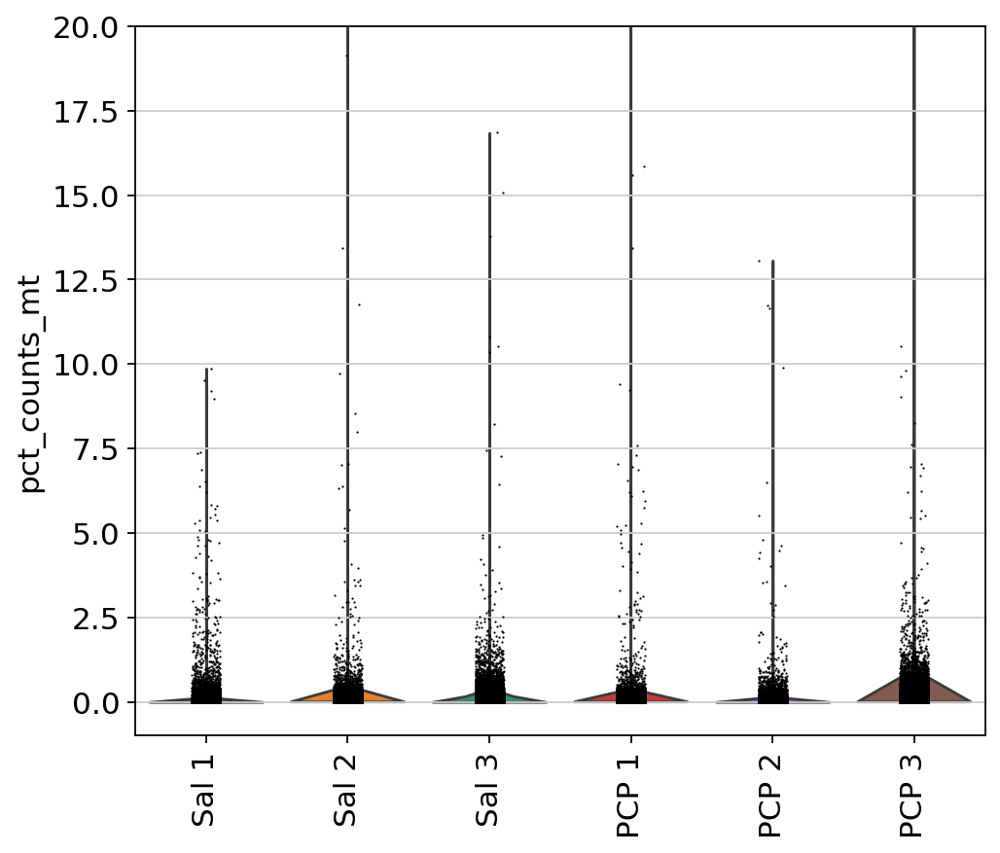

In [174]:
#%mt reads -> threshold ~5%
fig, ax = plt.subplots(figsize=(7,6))
sc.pl.violin(adata, keys='pct_counts_mt', groupby='Sample', rotation=90,show=False,ax=ax)
ax.set_ylim(bottom=-1,top=20)
plt.show()

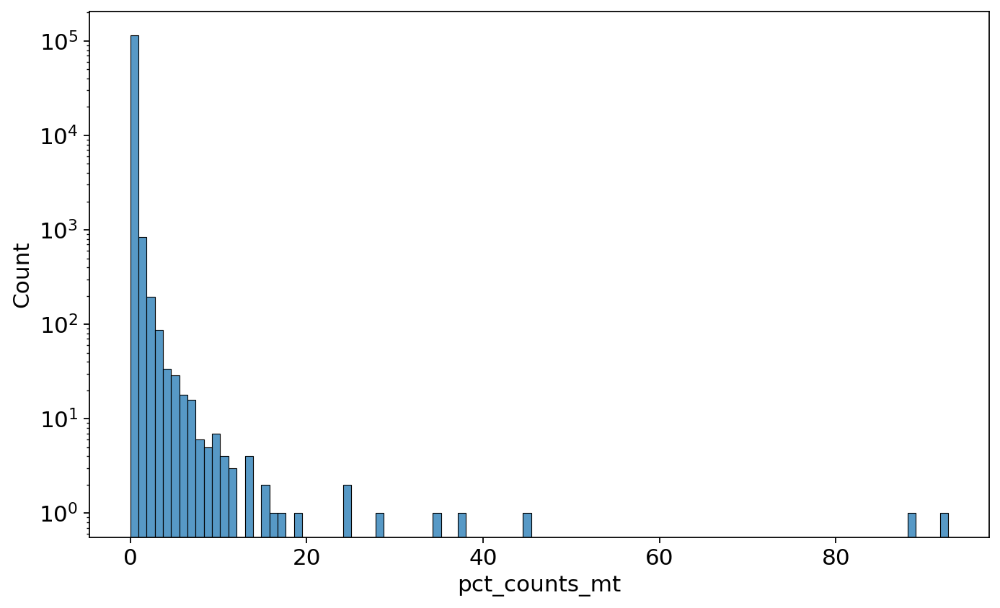

In [176]:
ax=sns.histplot(adata.obs,x='pct_counts_mt',bins=100)
ax.grid()
ax.set_yscale('log')

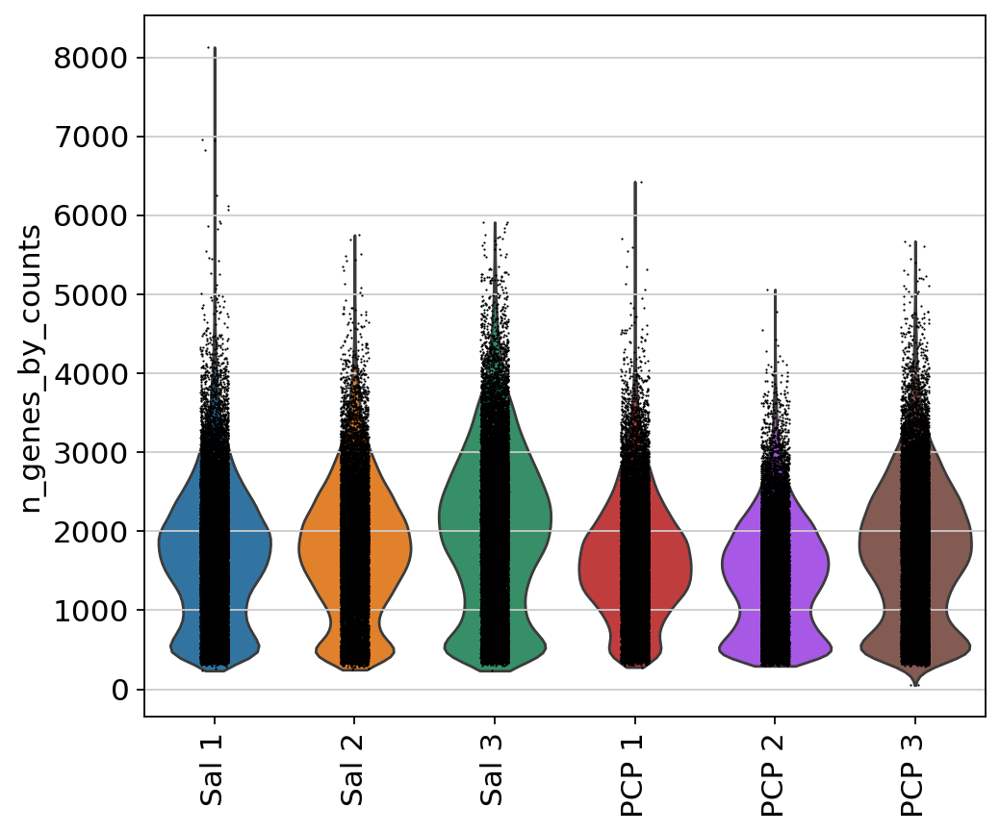

In [177]:
# number of genes per cell
fig, ax = plt.subplots(figsize=(7,6))
sc.pl.violin(adata, keys='n_genes_by_counts', groupby='Sample', rotation=90,show=False,ax=ax)
plt.show()

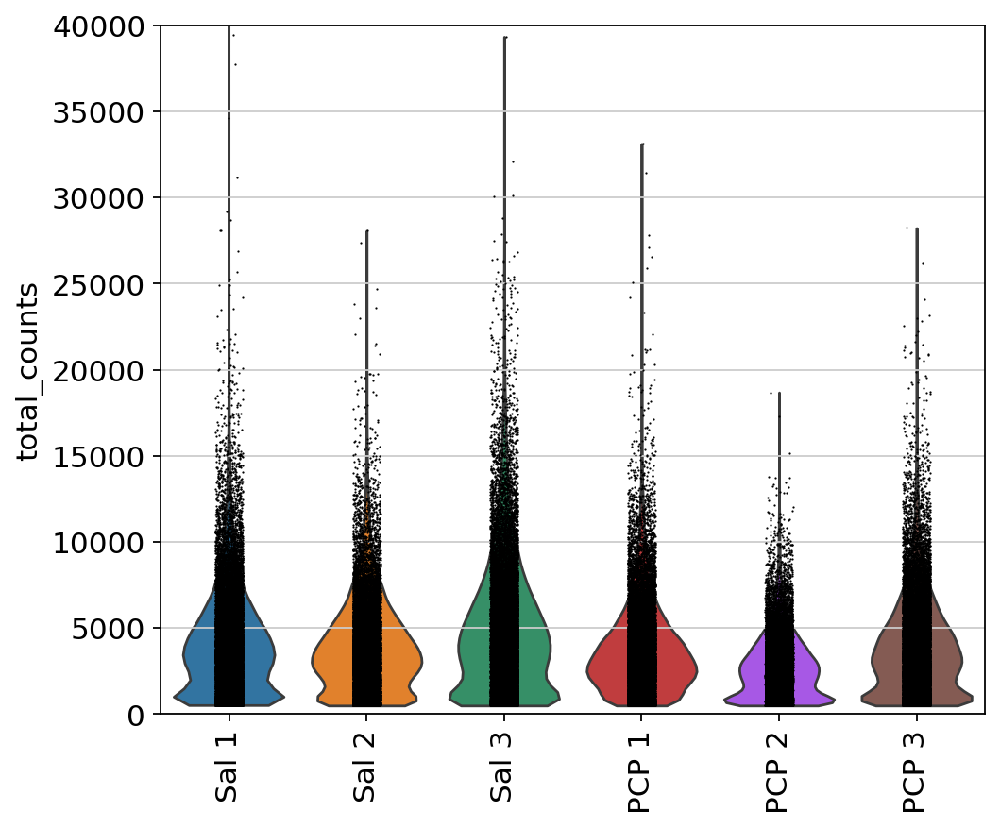

In [179]:
#n counts per cell
fig, ax = plt.subplots(figsize=(7,6))
sc.pl.violin(adata, keys='total_counts', groupby='Sample', rotation=90,show=False,ax=ax)
ax.set_ylim(bottom=-1,top=40000)
plt.show()

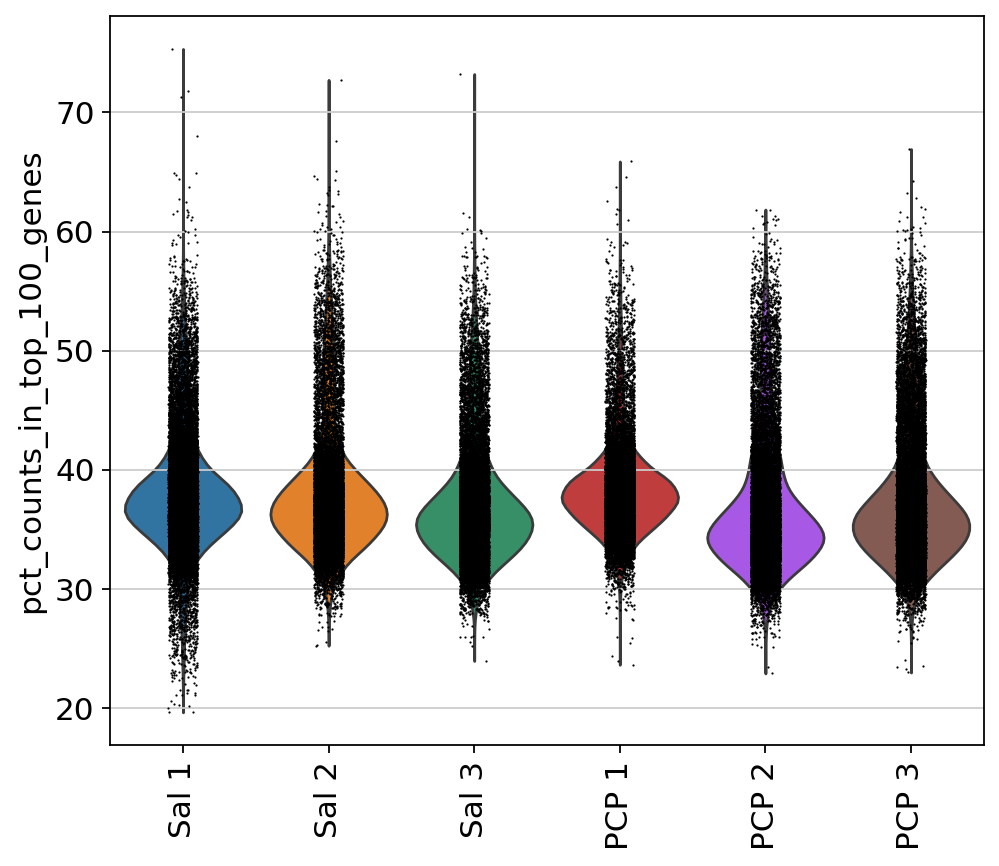

In [195]:
#n counts per cell
fig, ax = plt.subplots(figsize=(7,6))
sc.pl.violin(adata, keys='pct_counts_in_top_100_genes', groupby='Sample', rotation=90,show=False,ax=ax)
plt.show()

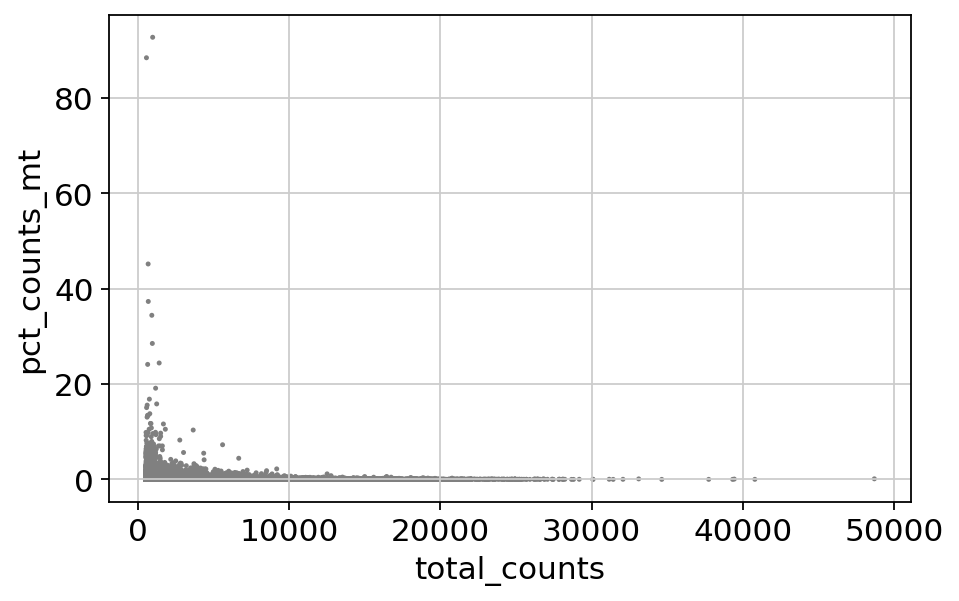

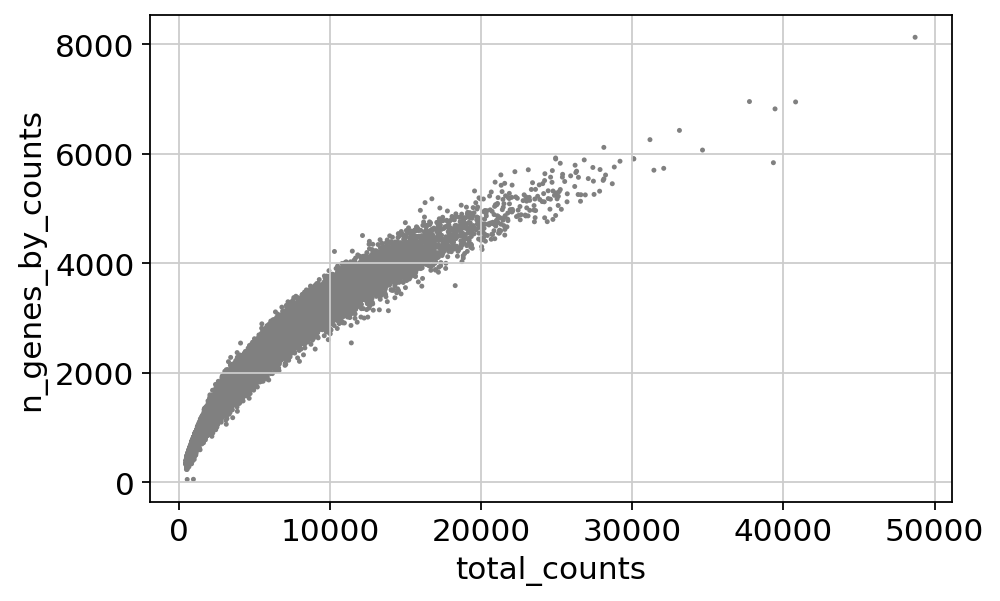

In [183]:
##QC -> by cell statistics; cell total counts x 
##========================
sc.set_figure_params(figsize=(6,4))
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', size=20)
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', size=20)

In [320]:
#run scrublet before normalise
#Do doublet detection with scrublet
#Retain all for now, filter later based on clustering QC
#==============================
import anndata as ad
sc.pp.scrublet(adata, batch_key="Sample")

In [322]:
adata.obs['predicted_doublet'].value_counts()

predicted_doublet
False    108850
True       6861
Name: count, dtype: int64

In [7]:
#PROCESS NORMALISE -> 
#Process
##========================
#Filter based on QC
adata = adata[adata.obs.pct_counts_mt < 5, :]
#any upper limits for counts/genes? 
#% counts in top 100 genes? 

adata.raw = adata

#Normalise
##========================
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata, base=10)

AttributeError: 'DataFrame' object has no attribute 'pct_counts_mt'

In [338]:
#Filter to only highly expressed + marker genes -> NB this may need to be tweaked!!!
#Define marker genes
gaba_mark = ['Gad2', 'Gad1','Slc32a1', 'Sst', 'Pvalb', 'Lamp5', 'Vip']
glu_mark = ['Slc17a7', 'Slc17a6', 'Camk2a', 'Grin1', 'Gria1']
astro_mark = ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4', 'Glul']
oli_mark = ['Mbp', 'Mog', 'Cnp', 'Plp1','Sox10', 'Olig2', 'Olig1']
mi_mark = ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
opc_mark = ['Sox10', 'Olig2', 'Olig1']

comb_l = gaba_mark+glu_mark+astro_mark+oli_mark+mi_mark+opc_mark

#Plot variable vs non variable genes
#calculate dispersion (variance/mean) and mean for each gene; bin genes by mean; zscore genes by their means; select genes > threshold
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3.5, min_disp=0.4,batch_key="Sample")
print(f"{adata.var['highly_variable'].value_counts()} highly variable genes out of {len(adata.obs)}")
#Add in all marker genes
for i in comb_l:
    if adata.var.highly_variable[adata.var['gene']==i].values[0] == False: 
        adata.var.loc[adata.var['gene']==i,"highly_variable"] = True

#Retain only most variable genes
fdata = adata[:,adata.var.highly_variable]
#remove any cells that now have 0 counts
boole = np.squeeze(np.asarray(np.sum(fdata.X,axis=1)) > 0)
fdata = fdata[boole]

# sc.pp.regress_out(fdata, ['total_counts', 'pct_counts_mt'])
# sc.pp.scale(fdata, max_value=10)

highly_variable
False    15989
True      3494
Name: count, dtype: int64 highly variable genes out of 115619


In [339]:
fdata

View of AnnData object with n_obs × n_vars = 115616 × 3511
    obs: 'LibID', 'Sample', 'n_genes', 'n_counts', 'class_name', 'subclass_name', 'supertype_name', 'cluster_name', 'is_ctx_neuron', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'doublet_score', 'predicted_doublet', 'class_label', 'subclass_label', 'supertype_label', 'cluster_label'
    var: 'gene', 'genetype', 'n_counts', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'scrublet', 'log1p', 'hvg'

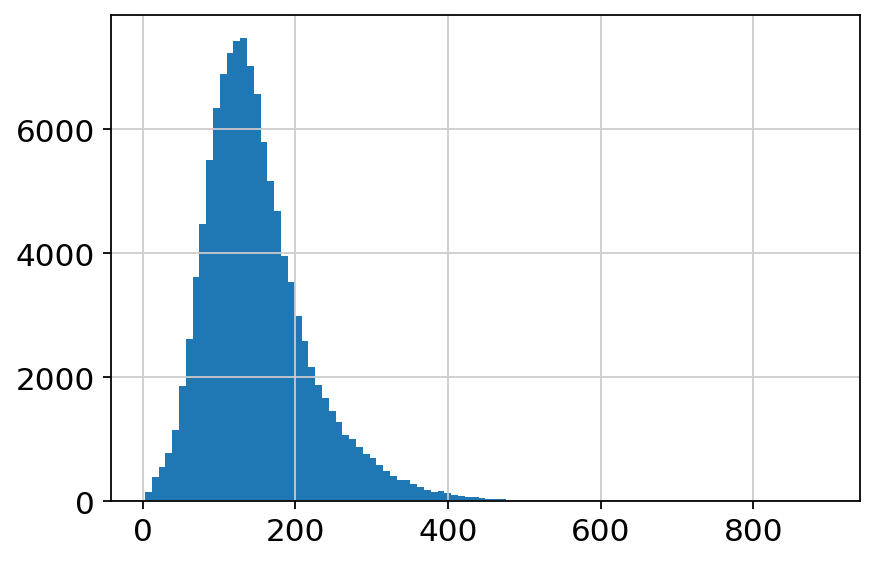

In [326]:
plt.hist(np.sum(fdata.X,axis=1)[:,0], bins=100)
plt.show()

In [340]:
#MMC labelling filter
# Weed out labels with too few observations
#==============================================
def min_obs(names,thresh=20):
    names = names.cat.add_categories('-')
    counts=names.value_counts()
    badnames=counts[counts<thresh]
    badcells=names.isin(badnames.index)
    print(f'{names.name}: Removing {len(badnames)}/{counts.shape[0]} categories, {badcells.sum()}/{badcells.shape[0]} cells')
    names[badcells]='-'
    return names

for clusters in ['class_name','subclass_name','supertype_name','cluster_name']:
    fdata.obs[clusters]=min_obs(fdata.obs[clusters].copy())

#clean up names
for category in ['class','subclass','supertype','cluster']:
    fdata.obs[f'{category}_label']=adata.obs[f'{category}_name'].str.replace(r'^[0-9]+ ','',regex=True)

class_name: Removing 8/34 categories, 42/115616 cells


/tmp/ipykernel_2759161/4102134361.py:14: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  fdata.obs[clusters]=min_obs(fdata.obs[clusters].copy())


subclass_name: Removing 167/236 categories, 719/115616 cells
supertype_name: Removing 409/590 categories, 1411/115616 cells
cluster_name: Removing 891/1280 categories, 3334/115616 cells


In [341]:
#save combined outputs
fdata.write_h5ad(f'{out_path}KIBM_adata_processed-filtered.h5ad')

In [139]:
#GLU VS GABA
gaba_mark = ['Gad2', 'Gad1','Slc32a1']
glu_mark = ['Slc17a7', 'Slc17a6']
data = subdata.X
names = subdata.var.index
glu_l, gaba_l, glu_name, gaba_name = pf.rank_genes(data, names, gaba_mark, glu_mark)

0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942


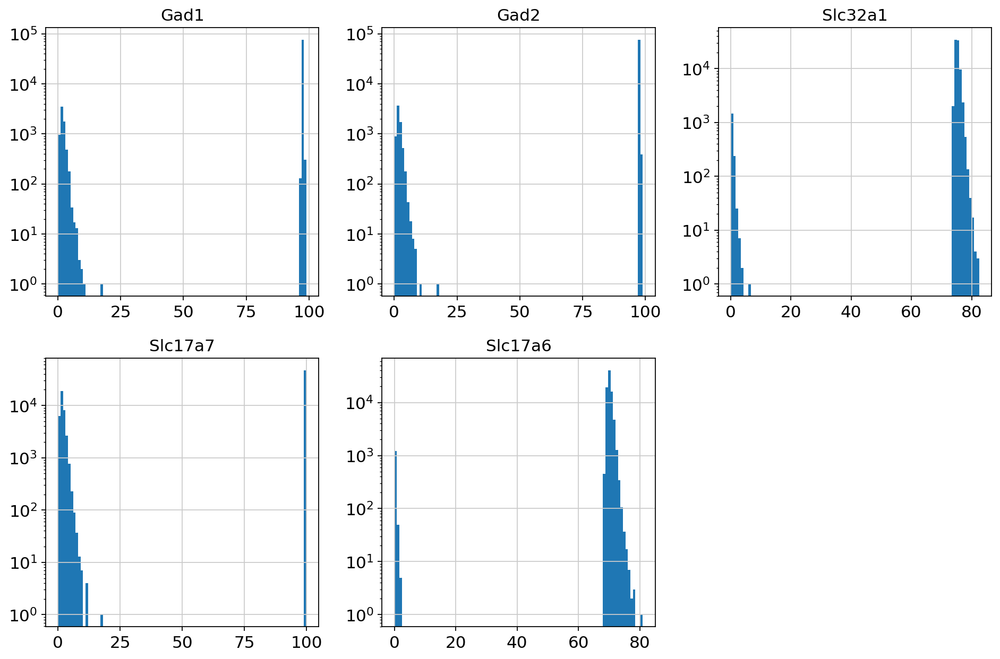

In [177]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming rank_l, glu_l, and gaba_l are already defined
# List of gene names and titles
genes = ['Gad1', 'Gad2', 'Slc32a1','Slc17a7', 'Slc17a6']
titles = ['Gad1', 'Gad2', 'Slc32a1','Slc17a7', 'Slc17a6']

# Create a figure and a set of subplots
fig, axs = plt.subplots(2, 3, figsize=(12, 8))  # 3 rows and 2 columns

# Flatten the array of axes for easier iteration
axs = axs.flatten()

# Loop through each gene and create the corresponding subplot
for i, curr in enumerate(genes):
    if curr in ['Slc17a7', 'Slc17a6']:  # Glutamatergic genes
        dist = np.asarray([rank_l[j][0][np.where(glu_l[j]==curr)] for j in range(len(glu_l))])
    else:  # GABAergic genes
        dist = np.asarray([rank_l[j][1][np.where(gaba_l[j]==curr)] for j in range(len(gaba_l))])
    
    axs[i].hist(dist, bins=100)#np.geomspace(0.5, 100, 100))
    axs[i].set_yscale('log')
    axs[i].set_title(titles[i])

# Hide any unused subplots (in case of odd number of plots)
for j in range(len(genes), len(axs)):
    fig.delaxes(axs[j])

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

In [427]:
#get vectors for each marker
gad1 = np.asarray([rank_l[j][1][np.where(gaba_name[j]=='Gad1')] for j in range(len(gaba_l))])
gad2 = np.asarray([rank_l[j][1][np.where(gaba_name[j]=='Gad2')] for j in range(len(gaba_l))])
slc32a1 = np.asarray([rank_l[j][1][np.where(gaba_name[j]=='Slc32a1')] for j in range(len(gaba_l))])
slc17a7 = np.asarray([rank_l[j][0][np.where(glu_name[j]=='Slc17a7')] for j in range(len(glu_l))])
slc17a6 = np.asarray([rank_l[j][0][np.where(glu_name[j]=='Slc17a6')] for j in range(len(glu_l))])

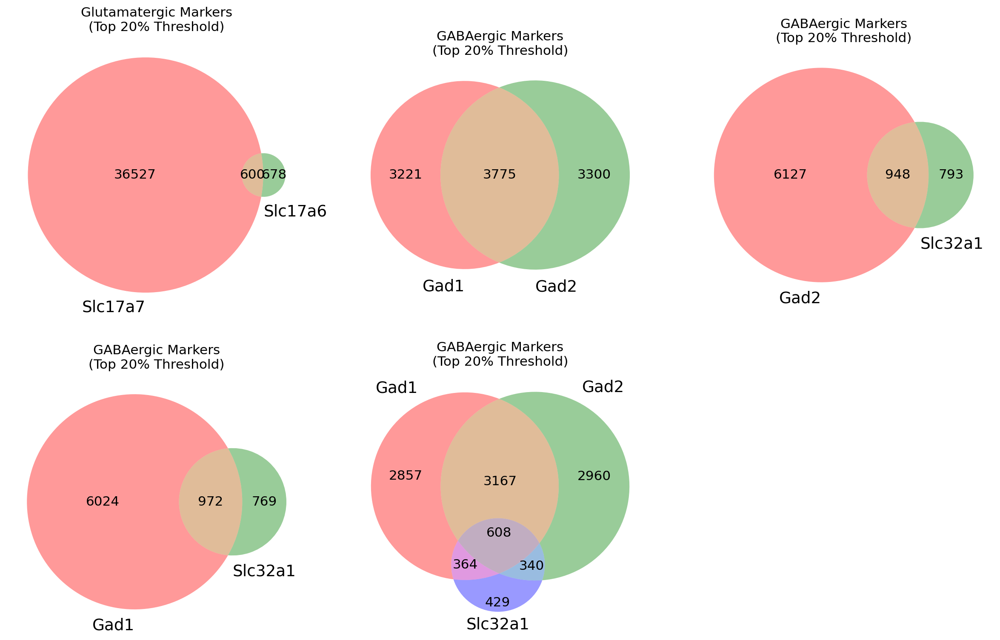

In [317]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn3

# Threshold for top 20%
thresh = 20

# Filter by threshold (bottom 20th percentile)
gad1_filtered = [i for i, rank in enumerate(gad1) if rank <= thresh]
gad2_filtered = [i for i, rank in enumerate(gad2) if rank <= thresh]
slc32a1_filtered = [i for i, rank in enumerate(slc32a1) if rank <= thresh]
slc17a7_filtered = [i for i, rank in enumerate(slc17a7) if rank <= thresh]
slc17a6_filtered = [i for i, rank in enumerate(slc17a6) if rank <= thresh]

# Create sets for Venn diagrams
set_slc17a7 = set(slc17a7_filtered)
set_slc17a6 = set(slc17a6_filtered)
set_gad1 = set(gad1_filtered)
set_gad2 = set(gad2_filtered)
set_slc32a1 = set(slc32a1_filtered)

# Plot Venn diagram for glutamatergic markers (Slc17a7 and Slc17a6)
plt.figure(figsize=(15, 10))
plt.subplot(231)
venn2([set_slc17a7, set_slc17a6], ('Slc17a7', 'Slc17a6'))
plt.title('Glutamatergic Markers\n(Top 20% Threshold)')

# Plot Venn diagram for GABAergic markers (Gad1 and Gad2)
plt.subplot(232)
venn2([set_gad1, set_gad2], ('Gad1', 'Gad2'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Plot Venn diagram for GABAergic markers (Gad2 and Slc32a1)
plt.subplot(233)
venn2([set_gad2, set_slc32a1], ('Gad2', 'Slc32a1'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Additional Venn diagram for Gad1 vs Slc32a1
plt.subplot(234)
venn2([set_gad1, set_slc32a1], ('Gad1', 'Slc32a1'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Three-way Venn diagram for Gad1, Gad2, and Slc32a1
plt.subplot(235)
venn3([set_gad1, set_gad2, set_slc32a1], ('Gad1', 'Gad2', 'Slc32a1'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plots
plt.show()

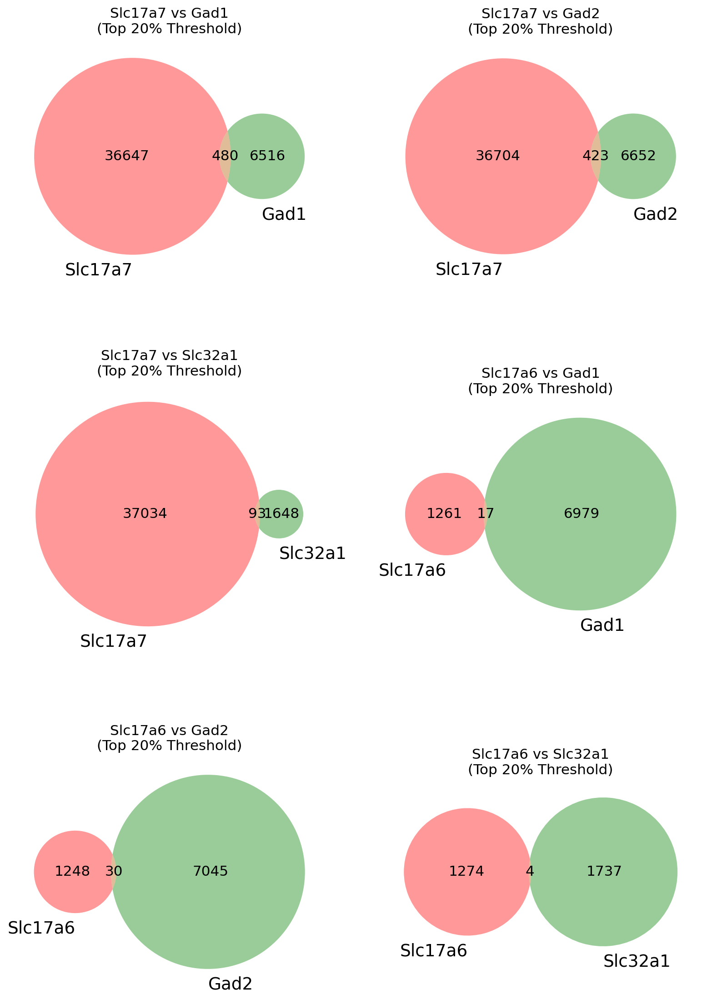

In [319]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib_venn import venn2

# Threshold for top 20%
thresh = 20

# Filter by threshold (bottom 20th percentile)
gad1_filtered = [i for i, rank in enumerate(gad1) if rank <= thresh]
gad2_filtered = [i for i, rank in enumerate(gad2) if rank <= thresh]
slc32a1_filtered = [i for i, rank in enumerate(slc32a1) if rank <= thresh]
slc17a7_filtered = [i for i, rank in enumerate(slc17a7) if rank <= thresh]
slc17a6_filtered = [i for i, rank in enumerate(slc17a6) if rank <= thresh]

# Create sets for Venn diagrams
set_slc17a7 = set(slc17a7_filtered)
set_slc17a6 = set(slc17a6_filtered)
set_gad1 = set(gad1_filtered)
set_gad2 = set(gad2_filtered)
set_slc32a1 = set(slc32a1_filtered)

# Plot Venn diagrams for each pair of GLU and GABA markers
plt.figure(figsize=(10, 15))

# Slc17a7 vs Gad1
plt.subplot(321)
venn2([set_slc17a7, set_gad1], ('Slc17a7', 'Gad1'))
plt.title('Slc17a7 vs Gad1\n(Top 20% Threshold)')

# Slc17a7 vs Gad2
plt.subplot(322)
venn2([set_slc17a7, set_gad2], ('Slc17a7', 'Gad2'))
plt.title('Slc17a7 vs Gad2\n(Top 20% Threshold)')

# Slc17a7 vs Slc32a1
plt.subplot(323)
venn2([set_slc17a7, set_slc32a1], ('Slc17a7', 'Slc32a1'))
plt.title('Slc17a7 vs Slc32a1\n(Top 20% Threshold)')

# Slc17a6 vs Gad1
plt.subplot(324)
venn2([set_slc17a6, set_gad1], ('Slc17a6', 'Gad1'))
plt.title('Slc17a6 vs Gad1\n(Top 20% Threshold)')

# Slc17a6 vs Gad2
plt.subplot(325)
venn2([set_slc17a6, set_gad2], ('Slc17a6', 'Gad2'))
plt.title('Slc17a6 vs Gad2\n(Top 20% Threshold)')

# Slc17a6 vs Slc32a1
plt.subplot(326)
venn2([set_slc17a6, set_slc32a1], ('Slc17a6', 'Slc32a1'))
plt.title('Slc17a6 vs Slc32a1\n(Top 20% Threshold)')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plots
plt.show()


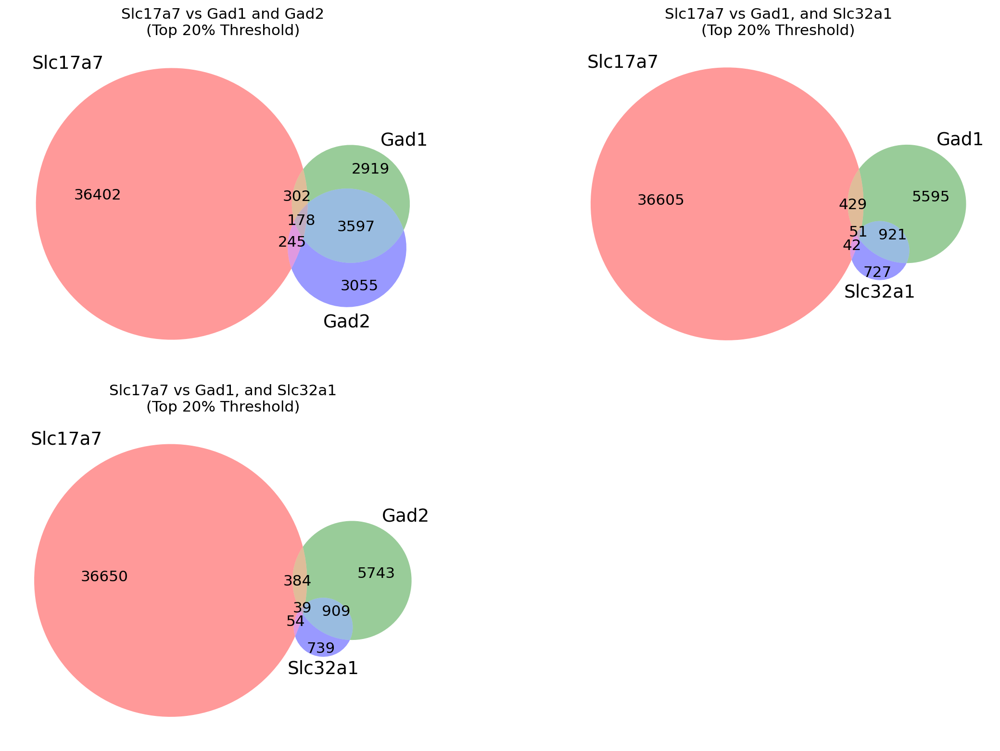

In [324]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn3

# Threshold for top 20%
thresh = 20

# Filter by threshold (bottom 20th percentile)
gad1_filtered = [i for i, rank in enumerate(gad1) if rank <= thresh]
gad2_filtered = [i for i, rank in enumerate(gad2) if rank <= thresh]
slc32a1_filtered = [i for i, rank in enumerate(slc32a1) if rank <= thresh]
slc17a7_filtered = [i for i, rank in enumerate(slc17a7) if rank <= thresh]

# Create sets for Venn diagrams
set_slc17a7 = set(slc17a7_filtered)
set_gad1 = set(gad1_filtered)
set_gad2 = set(gad2_filtered)
set_slc32a1 = set(slc32a1_filtered)

# Plot Venn diagrams for intersections
plt.figure(figsize=(15, 10))

# Slc17a7 vs Gad1 and Gad2
plt.subplot(221)
venn3([set_slc17a7, set_gad1, set_gad2], ('Slc17a7', 'Gad1', 'Gad2'))
plt.title('Slc17a7 vs Gad1 and Gad2\n(Top 20% Threshold)')

# Slc17a7 vs Gad1, Gad2, and Slc32a1
plt.subplot(222)
venn3([set_slc17a7, set_gad1, set_slc32a1], ('Slc17a7', 'Gad1', 'Slc32a1'))
plt.title('Slc17a7 vs Gad1, and Slc32a1\n(Top 20% Threshold)')

# Slc17a7 vs Gad1, Gad2, and Slc32a1
plt.subplot(223)
venn3([set_slc17a7, set_gad2, set_slc32a1], ('Slc17a7', 'Gad2', 'Slc32a1'))
plt.title('Slc17a7 vs Gad1, and Slc32a1\n(Top 20% Threshold)')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plots
plt.show()

In [344]:
#visualise survival analysis at single cell level
# threshold -> n cells co-expressing as you increase threshold 
thresh_l = np.arange(0,105, 5)

slc17a7_gad1, slc17a7_gad2, slc17a7_slc32a1, slc17a7_all=[],[],[],[]
for x,thresh in enumerate(thresh_l):
    slc17a7_gad1.append(sum((slc17a7 < thresh) & (gad1<thresh)))
    slc17a7_gad2.append(sum((slc17a7 < thresh) & (gad2<thresh)))
    slc17a7_slc32a1.append(sum((slc17a7 < thresh) & (slc32a1<thresh)))
    slc17a7_all.append(sum((slc17a7 < thresh) & (slc32a1<thresh) & (gad1<thresh) & (gad2<thresh)))

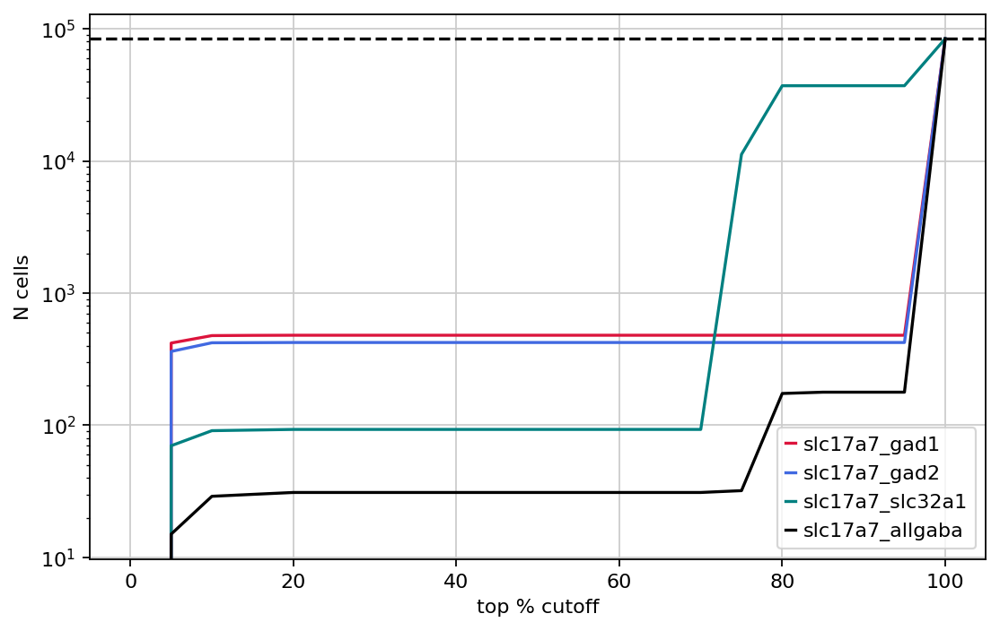

In [345]:
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(8,5))
plt.plot(thresh_l, slc17a7_gad1, label = 'slc17a7_gad1', c='crimson')
plt.plot(thresh_l, slc17a7_gad2, label = 'slc17a7_gad2', c='royalblue')
plt.plot(thresh_l, slc17a7_slc32a1, label = 'slc17a7_slc32a1', c='teal')
plt.plot(thresh_l, slc17a7_all, label = 'slc17a7_allgaba', c='k')

#plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
plt.savefig('prac.svg')
plt.show()

In [352]:
subdata

AnnData object with n_obs × n_vars = 84214 × 3511
    obs: 'LibID', 'Sample', 'n_genes', 'n_counts', 'class_name', 'subclass_name', 'supertype_name', 'cluster_name', 'is_ctx_neuron', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'doublet_score', 'predicted_doublet', 'class_label', 'subclass_label', 'supertype_label', 'cluster_label', 'condition', 'leiden'
    var: 'gene', 'genetype', 'n_counts', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'hvg', 'log1p', 'scrublet', 'pca', 'neighbors', 'leiden', 'umap', 'class_label_colors', 'subcl

In [859]:
#PCP vs saline
thresh=20
slc17a7_gad1 = (slc17a7 < thresh) & (gad1<thresh)
slc17a7_gad2 = (slc17a7 < thresh) & (gad2<thresh)
slc17a7_slc32a1 = (slc17a7 < thresh) & (slc32a1<thresh)
slc17a7_all = (slc17a7 < thresh) & (slc32a1<thresh) & (gad1<thresh) & (gad2<thresh)
new_df = pd.DataFrame()
new_df = pd.concat([new_df,subdata[slc17a7_gad1].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_gad2].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_slc32a1].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_all].obs.groupby('condition').count()['LibID']])
new_df.rename(columns={'LibID':'counts'}, inplace=True)
new_df['%'] = (new_df['counts'] / np.tile(subdata.obs.groupby('condition').count()['LibID'].values,4)) * 100
new_df['split'] = ['slc17a7_gad1','slc17a7_gad1','slc17a7_gad2','slc17a7_gad2','slc17a7_slc32a1','slc17a7_slc32a1','slc17a7_all', 'slc17a7_all']

/tmp/ipykernel_3437533/4039994457.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_df = pd.concat([new_df,subdata[slc17a7_gad1].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/4039994457.py:8: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  new_df = pd.concat([new_df,subdata[slc17a7_gad1].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/4039994457.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt

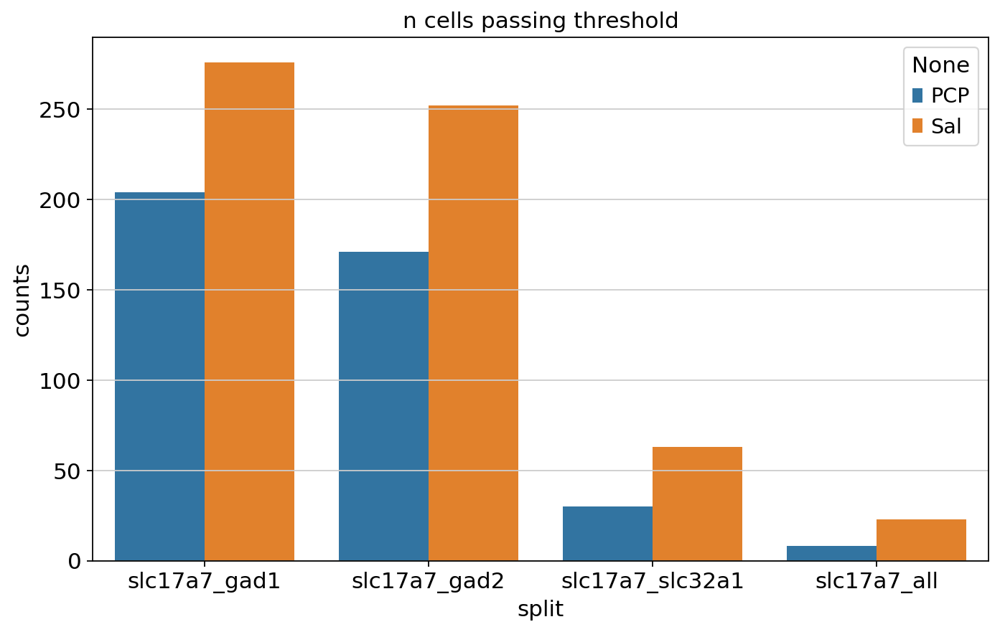

In [860]:
sns.barplot(new_df, x = 'split', y='counts', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()

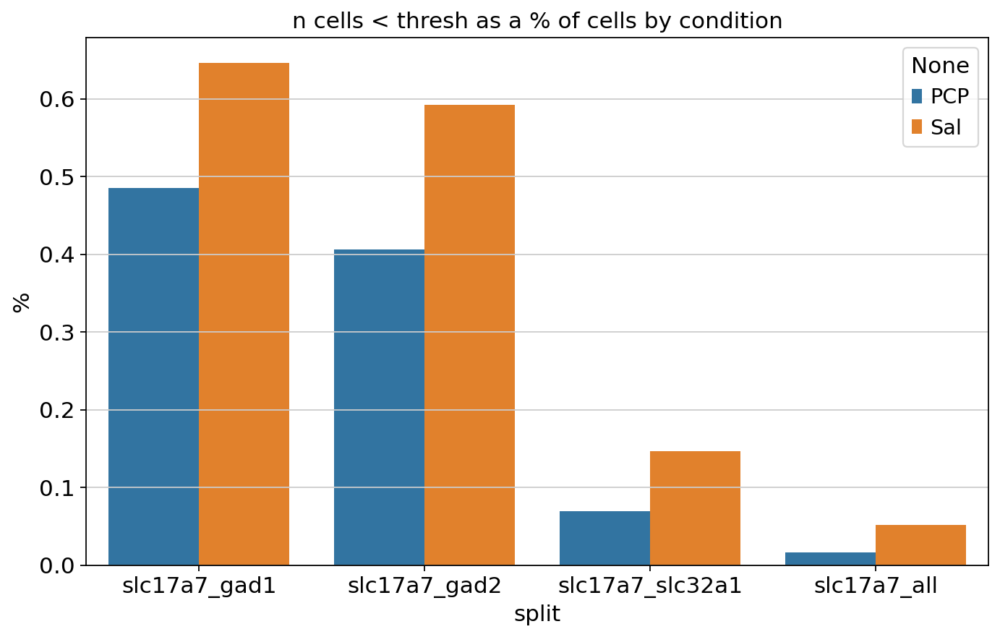

In [852]:
sns.barplot(new_df, x = 'split', y='%', hue = new_df.index)
plt.title('n cells < thresh as a % of cells by condition')
plt.show()

In [437]:
subdata[gad1].obs.groupby('condition')

/tmp/ipykernel_3437533/2914563809.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  subdata[gad1].obs.groupby('condition')


In [439]:
subdata[gad1].obs['condition']

GCACGGTCATTCATCT-1-JD_47_1_2    PCP
ACGTAACTCGCAATGT-1-JD_47_1_2    PCP
ACGTAACTCGCAATGT-1-JD_47_1_2    PCP
TTCTGTAGTTCAGGTT-1-JD_47_1_2    PCP
ACGTAACTCGCAATGT-1-JD_47_1_2    PCP
                               ... 
GAAGCCCAGAATAACC-1-JD_47_1_2    PCP
GAAGCCCAGAATAACC-1-JD_47_1_2    PCP
GAAGCCCAGAATAACC-1-JD_47_1_2    PCP
TCTGGCTGTCCCTAAA-1-JD_47_1_2    PCP
ATTCTACCAGCCTTCT-1-JD_47_1_2    PCP
Name: condition, Length: 84214, dtype: category
Categories (1, object): ['PCP']

In [503]:
subdata.obs.groupby('condition').count()['LibID']

/tmp/ipykernel_3437533/3442993054.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  subdata.obs.groupby('condition').count()['LibID']


condition
PCP    41827
Sal    42387
Name: LibID, dtype: int64

In [541]:
#ncells crossing one or the other by condition
thresh=20
gad1_ = gad1<thresh
slc17a7_ = slc17a7 < thresh
gad2_ = gad2<thresh
slc32a1_ = slc32a1<thresh

new_df = pd.DataFrame()
new_df = pd.concat([new_df,subdata[gad1_].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[gad2_].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc32a1_].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_].obs.groupby('condition').count()['LibID']])
new_df.rename(columns={'LibID':'counts'}, inplace=True)
tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']
new_df['%'] = (new_df['counts'] / np.tile([tot_pcp,tot_sal],4)) * 100
new_df['marker'] = ['gad1','gad1','gad2','gad2','slc32a1','slc32a1','slc17a7', 'slc17a7']

/tmp/ipykernel_3437533/3111368949.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_df = pd.concat([new_df,subdata[gad1_].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/3111368949.py:9: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  new_df = pd.concat([new_df,subdata[gad1_].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/3111368949.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future d

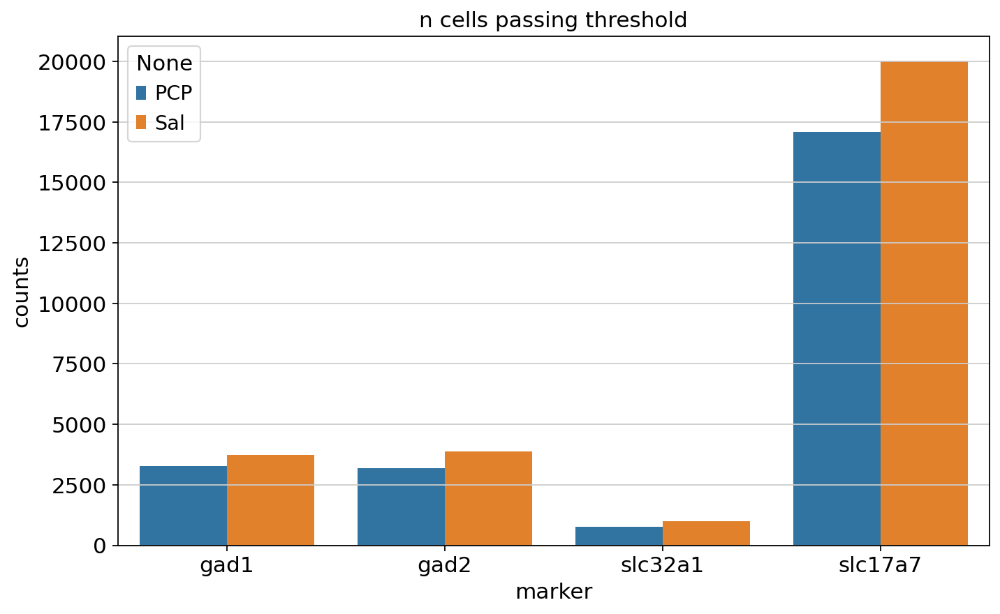

In [506]:
sns.barplot(new_df, x = 'marker', y='counts', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()

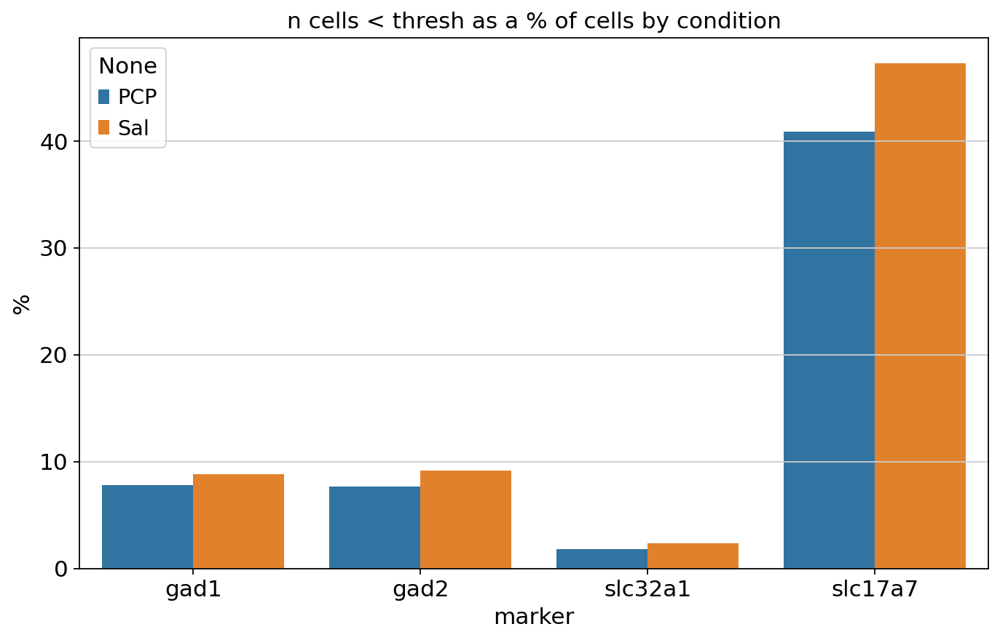

In [507]:
sns.barplot(new_df, x = 'marker', y='%', hue = new_df.index)
plt.title('n cells < thresh as a % of cells by condition')
plt.show()

In [346]:
#look at co-expression by cluster -> coarsse

#dic -> region -> glu/gaba -> gene -> % vec
dic = {}
for curr_reg in subdata.obs['class_label'].unique():
    dic.update({curr_reg:{}})
    for curr_cell in ['GLU', 'GABA']:
        dic[curr_reg].update({curr_cell:{}})
        if curr_cell=='GLU':
            curr_l = glu_l[subdata.obs['class_label'] == curr_reg]
            curr_name = glu_name[subdata.obs['class_label'] == curr_reg]
            gene_l = glu_mark
        
        if curr_cell=='GABA':
            curr_l = gaba_l[subdata.obs['class_label'] == curr_reg]
            curr_name = gaba_name[subdata.obs['class_label'] == curr_reg]
            gene_l = gaba_mark
    
        for gene in gene_l:
            dic[curr_reg][curr_cell].update({gene:curr_l[curr_name == gene]})

In [826]:
new_df = pd.DataFrame()
reg_name,marker,norm = [],[],[]
thresh=20
slc17a7_gad1 = (slc17a7 < thresh) & (gad1<thresh)
slc17a7_gad2 = (slc17a7 < thresh) & (gad2<thresh)
slc17a7_slc32a1 = (slc17a7 < thresh) & (slc32a1<thresh)
slc17a7_all = (slc17a7 < thresh) & (slc32a1<thresh) & (gad1<thresh) & (gad2<thresh)
tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']

for curr_reg in subdata.obs['class_name'].unique():
    sub_df = pd.DataFrame()
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_gad1==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_gad2==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_slc32a1==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_all==True)[:,0]].obs.groupby('condition').count()['LibID']])    
    marker = np.concatenate([
        np.repeat('slc17a7_gad1', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_gad1 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_gad2', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_gad2 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_slc32a1', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_slc32a1 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_all', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_all == True)[:, 0]].obs.groupby('condition').count()['LibID']))
    ])
    sub_df['set'] = np.ravel(marker)
    sub_df['class'] = np.repeat(curr_reg,len(sub_df))

    new_df = pd.concat([new_df,sub_df])

new_df.rename(columns={'LibID':'n_cells'}, inplace=True)
new_df['condition'] = new_df.index
new_df['%'] = new_df['n_cells']

new_df.loc[new_df['condition'] == 'PCP', '%'] = new_df.loc[new_df['condition'] == 'PCP', '%'] / tot_pcp
new_df.loc[new_df['condition'] == 'Sal', '%'] = new_df.loc[new_df['condition'] == 'Sal', '%'] / tot_sal


/tmp/ipykernel_3437533/374229490.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
/tmp/ipykernel_3437533/374229490.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']
/tmp/ipykernel_3437533/374229490.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sub_df = pd.concat([sub_df,subdata

In [827]:
#now sum over PCP saline for totals
curr = pd.DataFrame(new_df.groupby(['class', 'set']).sum()['n_cells'])
curr['%'] = (curr.values[:,0] / subdata.obs.groupby('class_name').count()['LibID'].loc[np.asarray([i[0] for i in curr.index])].values)*100  # % of that cluster that pass threshold
curr

/tmp/ipykernel_3437533/2713163650.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  curr['%'] = (curr.values[:,0] / subdata.obs.groupby('class_name').count()['LibID'].loc[np.asarray([i[0] for i in curr.index])].values)*100  # % of that cluster that pass threshold


n_cells         %
class             set                               
01 IT-ET Glut     slc17a7_all          6.0  0.012745
                  slc17a7_gad1       254.0  0.539542
                  slc17a7_gad2       201.0  0.426960
                  slc17a7_slc32a1     38.0  0.080719
02 NP-CT-L6b Glut slc17a7_all         12.0  0.049710
                  slc17a7_gad1       161.0  0.666943
                  slc17a7_gad2       136.0  0.563380
                  slc17a7_slc32a1     35.0  0.144988
06 CTX-CGE GABA   slc17a7_all          3.0  0.089047
                  slc17a7_gad1        15.0  0.445236
                  slc17a7_gad2        17.0  0.504601
                  slc17a7_slc32a1      4.0  0.118730
07 CTX-MGE GABA   slc17a7_all          8.0  0.089979
                  slc17a7_gad1        37.0  0.416151
                  slc17a7_gad2        56.0  0.629850
                  slc17a7_slc32a1     12.0  0.134968
08 CNU-MGE GABA   slc17a7_gad1        10.0  3.690037
                  slc17a7_gad2         8.0  2.952030
                  slc17a7_slc32a1      1.0  0.369004
10 LSX GABA       slc17a7_all          1.0  0.350877
                  slc17a7_gad1         2.0  0.701754
                  slc17a7_gad2         4.0  1.403509
                  slc17a7_slc32a1      2.0  0.701754
20 MB GABA        slc17a7_all          1.0  3.125000
                  slc17a7_gad1         1.0  3.125000
                  slc17a7_gad2         1.0  3.125000
                  slc17a7_slc32a1      1.0  3.125000

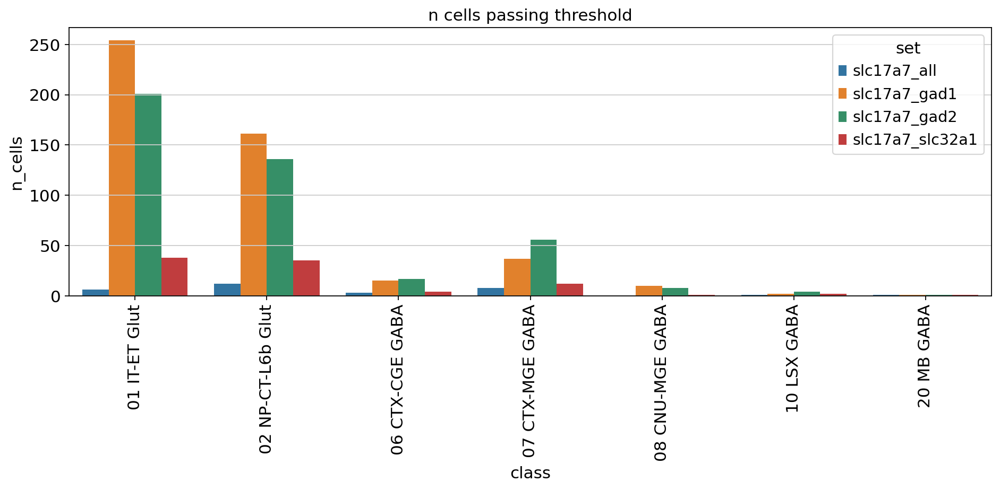

In [624]:
curr = pd.DataFrame(curr)

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='set')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

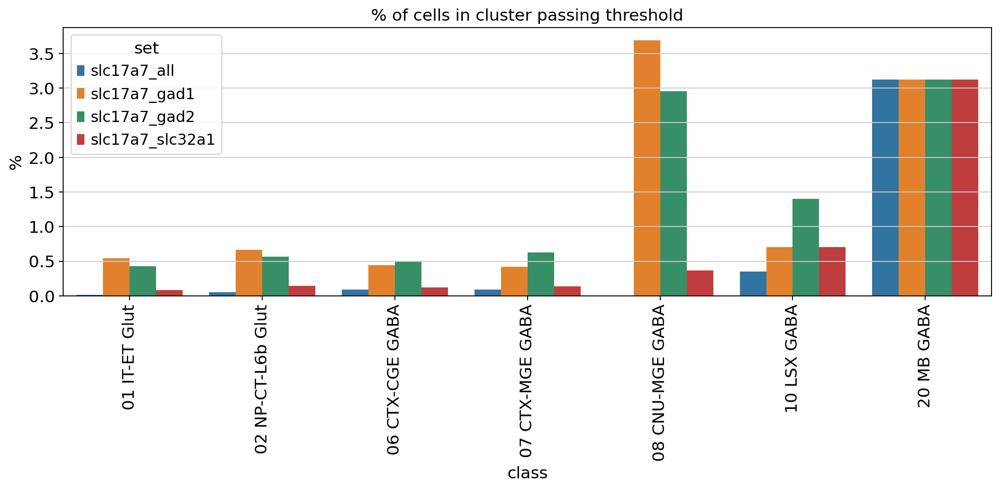

In [625]:
curr = pd.DataFrame(curr)

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%', hue='set')
plt.title('% of cells in cluster passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

In [705]:
new_df[new_df['set']=='slc17a7_gad1']

,n_cells,set,class,condition,%
PCP,59.0,slc17a7_gad1,02 NP-CT-L6b Glut,PCP,0.001411
Sal,102.0,slc17a7_gad1,02 NP-CT-L6b Glut,Sal,0.002406
PCP,116.0,slc17a7_gad1,01 IT-ET Glut,PCP,0.002773
Sal,138.0,slc17a7_gad1,01 IT-ET Glut,Sal,0.003256
PCP,19.0,slc17a7_gad1,07 CTX-MGE GABA,PCP,0.000454
Sal,18.0,slc17a7_gad1,07 CTX-MGE GABA,Sal,0.000425
PCP,2.0,slc17a7_gad1,10 LSX GABA,PCP,0.000048
PCP,6.0,slc17a7_gad1,06 CTX-CGE GABA,PCP,0.000143
Sal,9.0,slc17a7_gad1,06 CTX-CGE GABA,Sal,0.000212
PCP,1.0,slc17a7_gad1,08 CNU-MGE GABA,PCP,0.000024


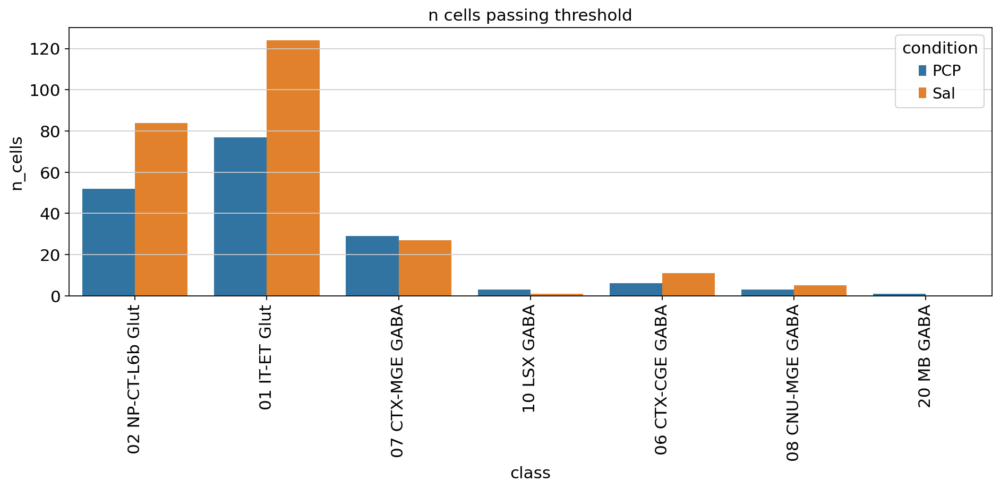

In [673]:
curr = new_df[new_df['set']=='slc17a7_gad2']

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

/tmp/ipykernel_3437533/915058785.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']
/tmp/ipykernel_3437533/915058785.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr['%_cluster'] = [i[0] for i in tot]


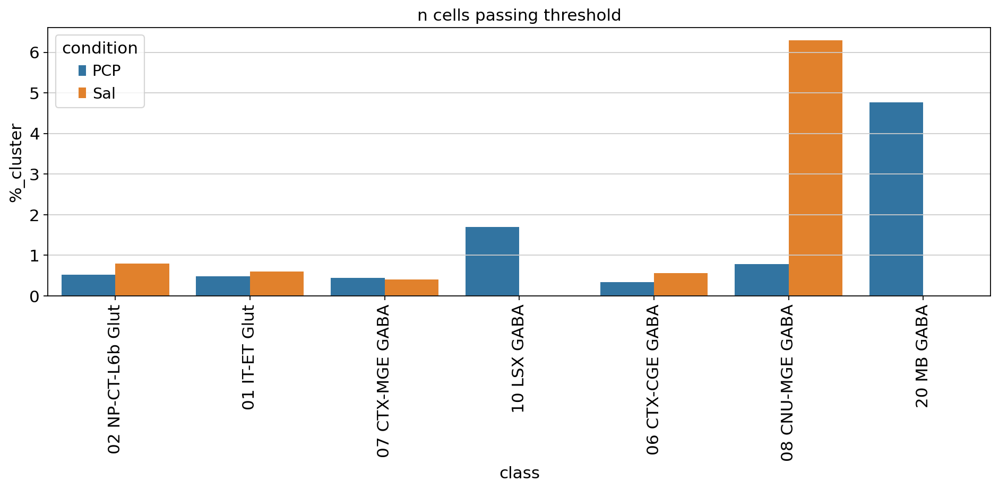

In [828]:
curr = new_df[new_df['set']=='slc17a7_gad1']
curr.reset_index(drop=True, inplace=True)
#curr['%_cluster'] = (curr['n_cells'] / subdata.obs.groupby('class_name').count()['LibID'].loc[curr['class']].values)*100  # % of that cluster that pass threshold
multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%_cluster', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

In [829]:
#look at co-expression by cluster -> granular

#dic -> region -> glu/gaba -> gene -> % vec
dic = {}
for curr_reg in subdata.obs['subclass_name'].unique():
    dic.update({curr_reg:{}})
    for curr_cell in ['GLU', 'GABA']:
        dic[curr_reg].update({curr_cell:{}})
        if curr_cell=='GLU':
            curr_l = glu_l[subdata.obs['subclass_name'] == curr_reg]
            curr_name = glu_name[subdata.obs['subclass_name'] == curr_reg]
            gene_l = glu_mark
        
        if curr_cell=='GABA':
            curr_l = gaba_l[subdata.obs['subclass_name'] == curr_reg]
            curr_name = gaba_name[subdata.obs['subclass_name'] == curr_reg]
            gene_l = gaba_mark
    
        for gene in gene_l:
            dic[curr_reg][curr_cell].update({gene:curr_l[curr_name == gene]})

In [830]:
new_df = pd.DataFrame()
reg_name,marker,norm = [],[],[]
thresh=20
slc17a7_gad1 = (slc17a7 < thresh) & (gad1<thresh)
slc17a7_gad2 = (slc17a7 < thresh) & (gad2<thresh)
slc17a7_slc32a1 = (slc17a7 < thresh) & (slc32a1<thresh)
slc17a7_all = (slc17a7 < thresh) & (slc32a1<thresh) & (gad1<thresh) & (gad2<thresh)
tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']

for curr_reg in subdata.obs['subclass_name'].unique():
    sub_df = pd.DataFrame()
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_gad1==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_gad2==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_slc32a1==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_all==True)[:,0]].obs.groupby('condition').count()['LibID']])    
    marker = np.concatenate([
        np.repeat('slc17a7_gad1', len(subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_gad1 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_gad2', len(subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_gad2 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_slc32a1', len(subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_slc32a1 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_all', len(subdata[(subdata.obs['subclass_name'] == curr_reg).values & (slc17a7_all == True)[:, 0]].obs.groupby('condition').count()['LibID']))
    ])
    sub_df['set'] = np.ravel(marker)
    sub_df['class'] = np.repeat(curr_reg,len(sub_df))

    new_df = pd.concat([new_df,sub_df])

new_df.rename(columns={'LibID':'n_cells'}, inplace=True)
new_df['condition'] = new_df.index
new_df['%'] = new_df['n_cells']

new_df.loc[new_df['condition'] == 'PCP', '%'] = new_df.loc[new_df['condition'] == 'PCP', '%'] / tot_pcp
new_df.loc[new_df['condition'] == 'Sal', '%'] = new_df.loc[new_df['condition'] == 'Sal', '%'] / tot_sal


/tmp/ipykernel_3437533/2273107221.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
/tmp/ipykernel_3437533/2273107221.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']
/tmp/ipykernel_3437533/2273107221.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sub_df = pd.concat([sub_df,subd

In [831]:
#now sum over PCP saline for totals
curr = pd.DataFrame(new_df.groupby(['class', 'set']).sum()['n_cells'])
curr['%'] = (curr.values[:,0] / subdata.obs.groupby('subclass_name').count()['LibID'].loc[np.asarray([i[0] for i in curr.index])].values)*100  # % of that cluster that pass threshold
curr

/tmp/ipykernel_3437533/2464830235.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  curr['%'] = (curr.values[:,0] / subdata.obs.groupby('subclass_name').count()['LibID'].loc[np.asarray([i[0] for i in curr.index])].values)*100  # % of that cluster that pass threshold


n_cells         %
class                     set                               
001 CLA-EPd-CTX Car3 Glut slc17a7_gad1         4.0  1.932367
                          slc17a7_gad2         2.0  0.966184
002 IT EP-CLA Glut        slc17a7_gad1         3.0  1.960784
004 L6 IT CTX Glut        slc17a7_all          1.0  0.011680
                          slc17a7_gad1        28.0  0.327026
...                                            ...       ...
071 LSX Prdm12 Zeb2 Gaba  slc17a7_slc32a1      2.0  0.934579
213 SCsg Gabrr2 Gaba      slc17a7_all          1.0  3.125000
                          slc17a7_gad1         1.0  3.125000
                          slc17a7_gad2         1.0  3.125000
                          slc17a7_slc32a1      1.0  3.125000

[72 rows x 2 columns]

In [824]:
curr

n_cells         %
class                     set                               
001 CLA-EPd-CTX Car3 Glut slc17a7_gad1         4.0  1.932367
                          slc17a7_gad2         2.0  0.966184
002 IT EP-CLA Glut        slc17a7_gad1         3.0  1.960784
004 L6 IT CTX Glut        slc17a7_all          1.0  0.011680
                          slc17a7_gad1        28.0  0.327026
...                                            ...       ...
071 LSX Prdm12 Zeb2 Gaba  slc17a7_slc32a1      2.0  0.934579
213 SCsg Gabrr2 Gaba      slc17a7_all          1.0  3.125000
                          slc17a7_gad1         1.0  3.125000
                          slc17a7_gad2         1.0  3.125000
                          slc17a7_slc32a1      1.0  3.125000

[72 rows x 2 columns]

In [ ]:
curr = new_df[new_df['set']=='slc17a7_gad2']
curr.reset_index(drop=True, inplace=True)
#curr['%_cluster'] = (curr['n_cells'] / subdata.obs.groupby('class_name').count()['LibID'].loc[curr['class']].values)*100  # % of that cluster that pass threshold
multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]


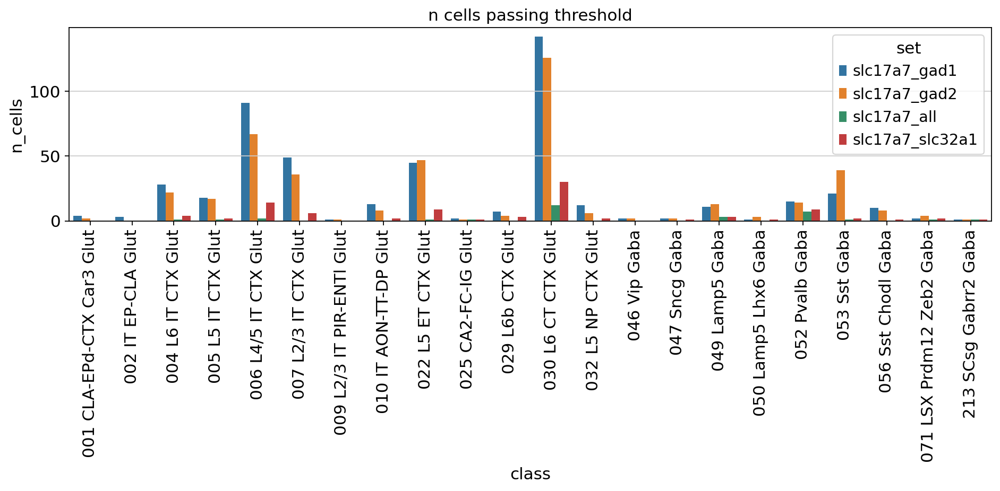

In [678]:
curr = pd.DataFrame(curr)

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='set')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

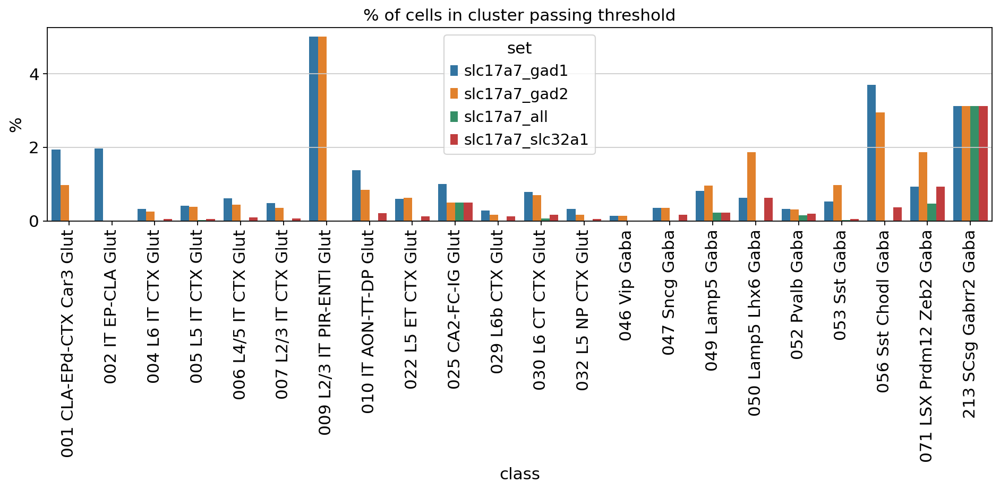

In [679]:
curr = pd.DataFrame(curr)

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%', hue='set')
plt.title('% of cells in cluster passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:


curr.reset_index(drop=True, inplace=True)
multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]


In [834]:


curr.reset_index(drop=True, inplace=True)
multi = subdata.obs.groupby(['subclass_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]


/tmp/ipykernel_3437533/804478176.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  multi = subdata.obs.groupby(['subclass_name', 'condition']).count()['LibID']
/tmp/ipykernel_3437533/804478176.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr['%_cluster'] = [i[0] for i in tot]


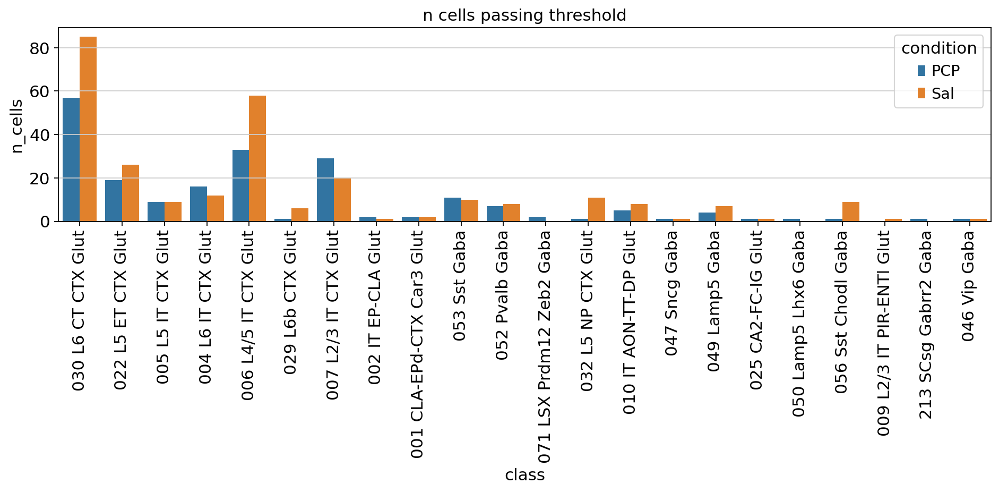

In [837]:
#curr = new_df[new_df['set']=='slc17a7_gad1']

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

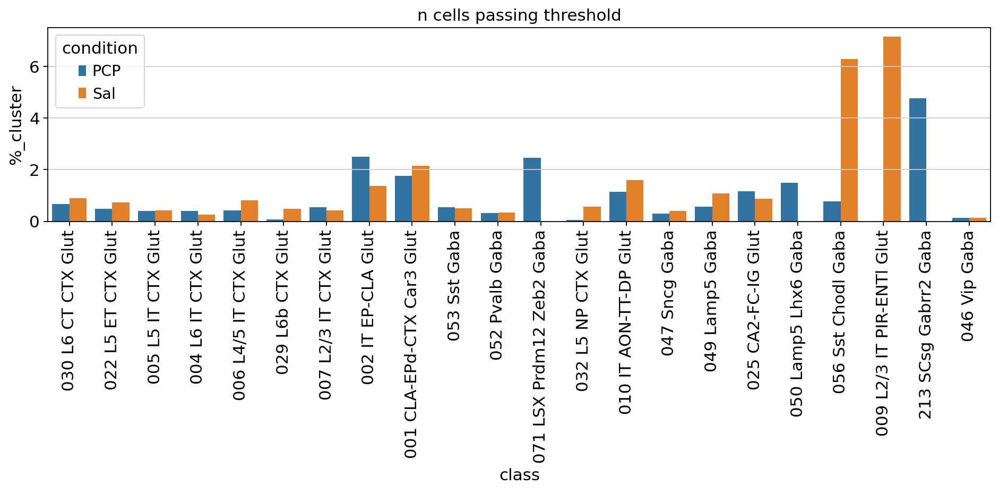

In [849]:

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%_cluster', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

In [913]:
%autoreload
#GLU VS GABA VS GLIA
gaba_mark = ['Sst', 'Pvalb', 'Lamp5', 'Vip']
glu_mark = ['Slc17a7', 'Slc17a6']
data = subdata.X
names = subdata.var['gene']
glu_l, gaba_l, glu_name, gaba_name = pf.rank_genes(data=data, names=names, glu_mark=glu_mark, gaba_mark=gaba_mark)

0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942


In [929]:
glu_l

array([[11.13642837, 77.69866135],
       [ 6.77869553, 74.70806038],
       [ 6.69324979, 74.45172316],
       ...,
       [68.78382227, 99.94303617],
       [68.86926801, 99.88607234],
       [69.06864141, 99.88607234]])

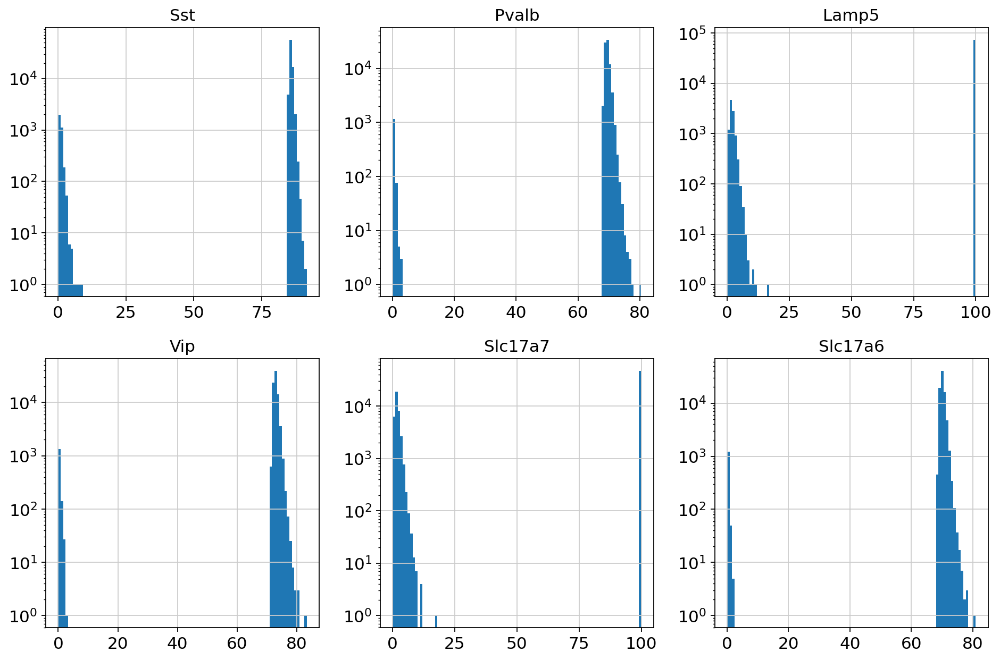

In [930]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming rank_l, glu_l, and gaba_l are already defined
# List of gene names and titles
genes = ['Sst', 'Pvalb', 'Lamp5', 'Vip', 'Slc17a7', 'Slc17a6']
titles = ['Sst', 'Pvalb', 'Lamp5', 'Vip', 'Slc17a7', 'Slc17a6']

# Create a figure and a set of subplots
fig, axs = plt.subplots(2, 3, figsize=(12, 8))  # 3 rows and 2 columns

# Flatten the array of axes for easier iteration
axs = axs.flatten()

# Loop through each gene and create the corresponding subplot
for i, curr in enumerate(genes):
    if curr in ['Slc17a7', 'Slc17a6']:  # Glutamatergic genes
        dist = np.asarray([glu_l[j][np.where(glu_name[j]==curr)] for j in range(len(glu_name))])
    else:  # GABAergic genes
        dist = np.asarray([gaba_l[j][np.where(gaba_name[j]==curr)] for j in range(len(gaba_name))])
    
    axs[i].hist(dist, bins=100)#np.geomspace(0.5, 100, 100))
    axs[i].set_yscale('log')
    axs[i].set_title(titles[i])

# Hide any unused subplots (in case of odd number of plots)
for j in range(len(genes), len(axs)):
    fig.delaxes(axs[j])

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

In [934]:
#get vectors for each marker
sst = np.asarray([gaba_l[j][np.where(gaba_name[j]=='Sst')] for j in range(len(gaba_l))])
pvalb = np.asarray([gaba_l[j][np.where(gaba_name[j]=='Pvalb')] for j in range(len(gaba_l))])
lamp5 = np.asarray([gaba_l[j][np.where(gaba_name[j]=='Lamp5')] for j in range(len(gaba_l))])
vip = np.asarray([gaba_l[j][np.where(gaba_name[j]=='Vip')] for j in range(len(gaba_l))])

slc17a7 = np.asarray([glu_l[j][np.where(glu_name[j]=='Slc17a7')] for j in range(len(glu_l))])
slc17a6 = np.asarray([glu_l[j][np.where(glu_name[j]=='Slc17a6')] for j in range(len(glu_l))])

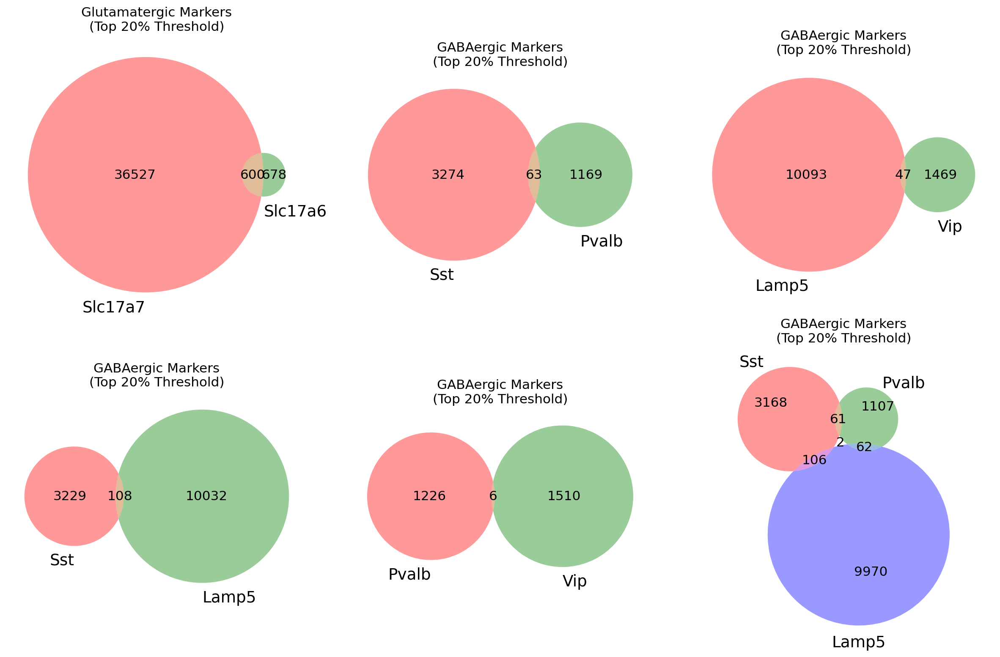

In [935]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn3

# Threshold for top 20%
thresh = 20

# Filter by threshold (bottom 20th percentile)
sst_filtered = [i for i, rank in enumerate(sst) if rank <= thresh]
pvalb_filtered = [i for i, rank in enumerate(pvalb) if rank <= thresh]
lamp5_filtered = [i for i, rank in enumerate(lamp5) if rank <= thresh]
vip_filtered = [i for i, rank in enumerate(vip) if rank <= thresh]
slc17a7_filtered = [i for i, rank in enumerate(slc17a7) if rank <= thresh]
slc17a6_filtered = [i for i, rank in enumerate(slc17a6) if rank <= thresh]

# Create sets for Venn diagrams
set_sst = set(sst_filtered)
set_pvalb = set(pvalb_filtered)
set_lamp5 = set(lamp5_filtered)
set_vip = set(vip_filtered)
set_slc17a7 = set(slc17a7_filtered)
set_slc17a6 = set(slc17a6_filtered)

# Plot Venn diagram for glutamatergic markers (Slc17a7 and Slc17a6)
plt.figure(figsize=(15, 10))
plt.subplot(231)
venn2([set_slc17a7, set_slc17a6], ('Slc17a7', 'Slc17a6'))
plt.title('Glutamatergic Markers\n(Top 20% Threshold)')

# Plot Venn diagram for GABAergic markers (Sst and Pvalb)
plt.subplot(232)
venn2([set_sst, set_pvalb], ('Sst', 'Pvalb'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Plot Venn diagram for GABAergic markers (Lamp5 and Vip)
plt.subplot(233)
venn2([set_lamp5, set_vip], ('Lamp5', 'Vip'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Additional Venn diagram for Sst vs Lamp5
plt.subplot(234)
venn2([set_sst, set_lamp5], ('Sst', 'Lamp5'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Additional Venn diagram for Pvalb vs Vip
plt.subplot(235)
venn2([set_pvalb, set_vip], ('Pvalb', 'Vip'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Three-way Venn diagram for Sst, Pvalb, and Lamp5
plt.subplot(236)
venn3([set_sst, set_pvalb, set_lamp5], ('Sst', 'Pvalb', 'Lamp5'))
plt.title('GABAergic Markers\n(Top 20% Threshold)')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plots
plt.show()


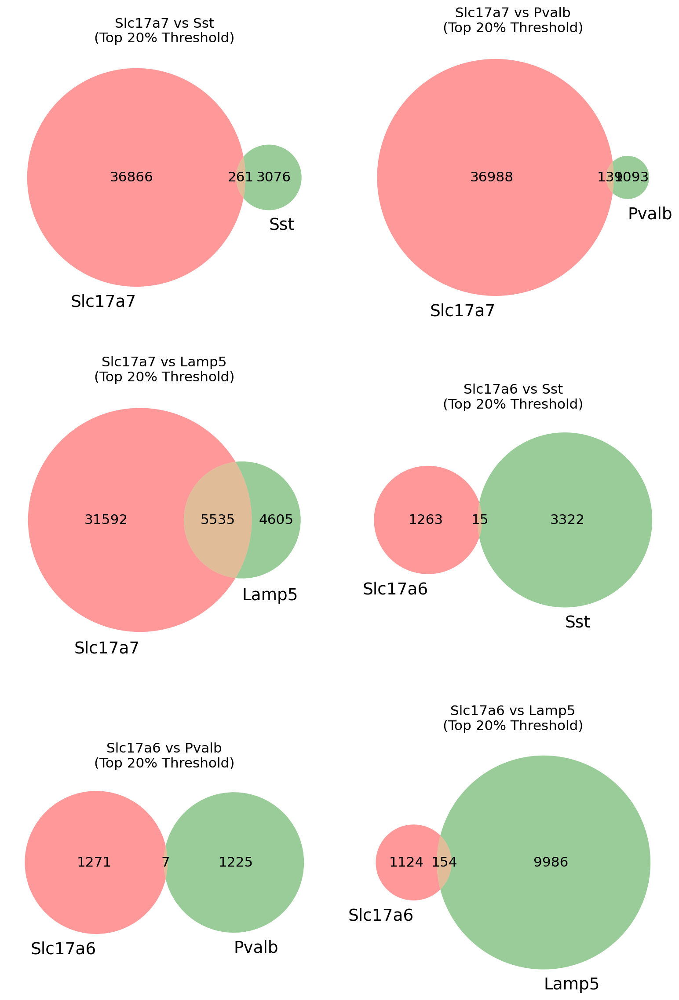

In [937]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib_venn import venn2

# Assuming gaba_l, gaba_name, glu_l, and glu_name are already defined as lists of arrays

# Get vectors for each marker
sst = np.asarray([gaba_l[j][np.where(gaba_name[j] == 'Sst')] for j in range(len(gaba_l))])
pvalb = np.asarray([gaba_l[j][np.where(gaba_name[j] == 'Pvalb')] for j in range(len(gaba_l))])
lamp5 = np.asarray([gaba_l[j][np.where(gaba_name[j] == 'Lamp5')] for j in range(len(gaba_l))])
vip = np.asarray([gaba_l[j][np.where(gaba_name[j] == 'Vip')] for j in range(len(gaba_l))])

slc17a7 = np.asarray([glu_l[j][np.where(glu_name[j] == 'Slc17a7')] for j in range(len(glu_l))])
slc17a6 = np.asarray([glu_l[j][np.where(glu_name[j] == 'Slc17a6')] for j in range(len(glu_l))])

# Threshold for top 20%
thresh = 20

# Filter by threshold (bottom 20th percentile)
sst_filtered = [i for i, rank in enumerate(sst) if rank <= thresh]
pvalb_filtered = [i for i, rank in enumerate(pvalb) if rank <= thresh]
lamp5_filtered = [i for i, rank in enumerate(lamp5) if rank <= thresh]
vip_filtered = [i for i, rank in enumerate(vip) if rank <= thresh]
slc17a7_filtered = [i for i, rank in enumerate(slc17a7) if rank <= thresh]
slc17a6_filtered = [i for i, rank in enumerate(slc17a6) if rank <= thresh]

# Create sets for Venn diagrams
set_sst = set(sst_filtered)
set_pvalb = set(pvalb_filtered)
set_lamp5 = set(lamp5_filtered)
set_vip = set(vip_filtered)
set_slc17a7 = set(slc17a7_filtered)
set_slc17a6 = set(slc17a6_filtered)

# Plot Venn diagrams for each pair of GLU and GABA markers
plt.figure(figsize=(10, 15))

# Slc17a7 vs SST
plt.subplot(321)
venn2([set_slc17a7, set_sst], ('Slc17a7', 'Sst'))
plt.title('Slc17a7 vs Sst\n(Top 20% Threshold)')

# Slc17a7 vs Pvalb
plt.subplot(322)
venn2([set_slc17a7, set_pvalb], ('Slc17a7', 'Pvalb'))
plt.title('Slc17a7 vs Pvalb\n(Top 20% Threshold)')

# Slc17a7 vs Lamp5
plt.subplot(323)
venn2([set_slc17a7, set_lamp5], ('Slc17a7', 'Lamp5'))
plt.title('Slc17a7 vs Lamp5\n(Top 20% Threshold)')

# Slc17a6 vs SST
plt.subplot(324)
venn2([set_slc17a6, set_sst], ('Slc17a6', 'Sst'))
plt.title('Slc17a6 vs Sst\n(Top 20% Threshold)')

# Slc17a6 vs Pvalb
plt.subplot(325)
venn2([set_slc17a6, set_pvalb], ('Slc17a6', 'Pvalb'))
plt.title('Slc17a6 vs Pvalb\n(Top 20% Threshold)')

# Slc17a6 vs Lamp5
plt.subplot(326)
venn2([set_slc17a6, set_lamp5], ('Slc17a6', 'Lamp5'))
plt.title('Slc17a6 vs Lamp5\n(Top 20% Threshold)')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plots
plt.show()


In [938]:
#visualise survival analysis at single cell level
# threshold -> n cells co-expressing as you increase threshold 
thresh_l = np.arange(0,105, 5)

slc17a7_sst, slc17a7_vip, slc17a7_lamp5, slc17a7_pvalb=[],[],[],[]
for x,thresh in enumerate(thresh_l):
    slc17a7_sst.append(sum((slc17a7 < thresh) & (sst<thresh)))
    slc17a7_vip.append(sum((slc17a7 < thresh) & (vip<thresh)))
    slc17a7_lamp5.append(sum((slc17a7 < thresh) & (lamp5<thresh)))
    slc17a7_pvalb.append(sum((slc17a7 < thresh) & (pvalb<thresh)))

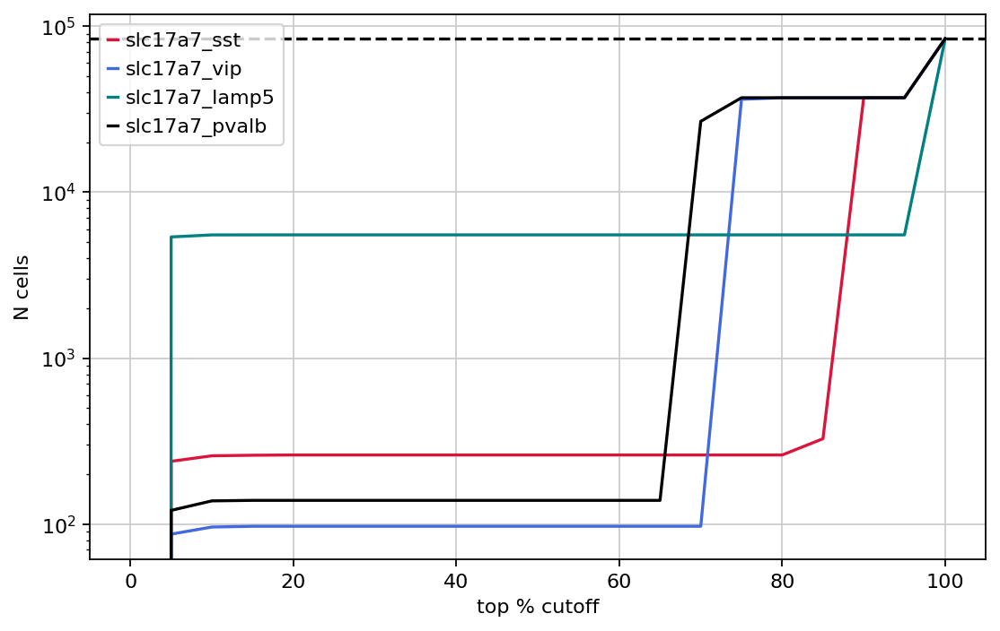

In [939]:
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(8,5))
plt.plot(thresh_l, slc17a7_sst, label = 'slc17a7_sst', c='crimson')
plt.plot(thresh_l, slc17a7_vip, label = 'slc17a7_vip', c='royalblue')
plt.plot(thresh_l, slc17a7_lamp5, label = 'slc17a7_lamp5', c='teal')
plt.plot(thresh_l, slc17a7_pvalb, label = 'slc17a7_pvalb', c='k')

#plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
plt.savefig('prac.svg')
plt.show()

In [942]:
#PCP vs saline
thresh=20
slc17a7_sst = (slc17a7 < thresh) & (sst<thresh)
slc17a7_vip = (slc17a7 < thresh) & (vip<thresh)
slc17a7_lamp5 = (slc17a7 < thresh) & (lamp5<thresh)
slc17a7_pvalb = (slc17a7 < thresh) & (pvalb<thresh)
new_df = pd.DataFrame()
new_df = pd.concat([new_df,subdata[slc17a7_sst].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_vip].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_lamp5].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_pvalb].obs.groupby('condition').count()['LibID']])
new_df.rename(columns={'LibID':'counts'}, inplace=True)
new_df['%'] = (new_df['counts'] / np.tile(subdata.obs.groupby('condition').count()['LibID'].values,4)) * 100
new_df['split'] = ['slc17a7_sst','slc17a7_sst','slc17a7_vip','slc17a7_vip','slc17a7_lamp5','slc17a7_lamp5','slc17a7_pvalb', 'slc17a7_pvalb']

/tmp/ipykernel_3437533/3550379337.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_df = pd.concat([new_df,subdata[slc17a7_sst].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/3550379337.py:8: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  new_df = pd.concat([new_df,subdata[slc17a7_sst].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/3550379337.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt t

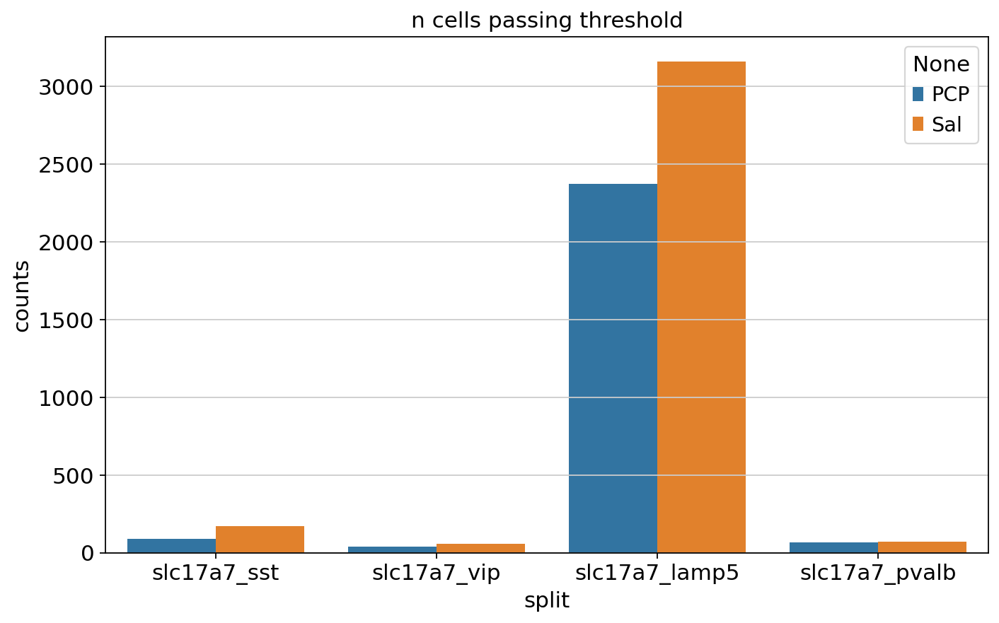

In [943]:
sns.barplot(new_df, x = 'split', y='counts', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()

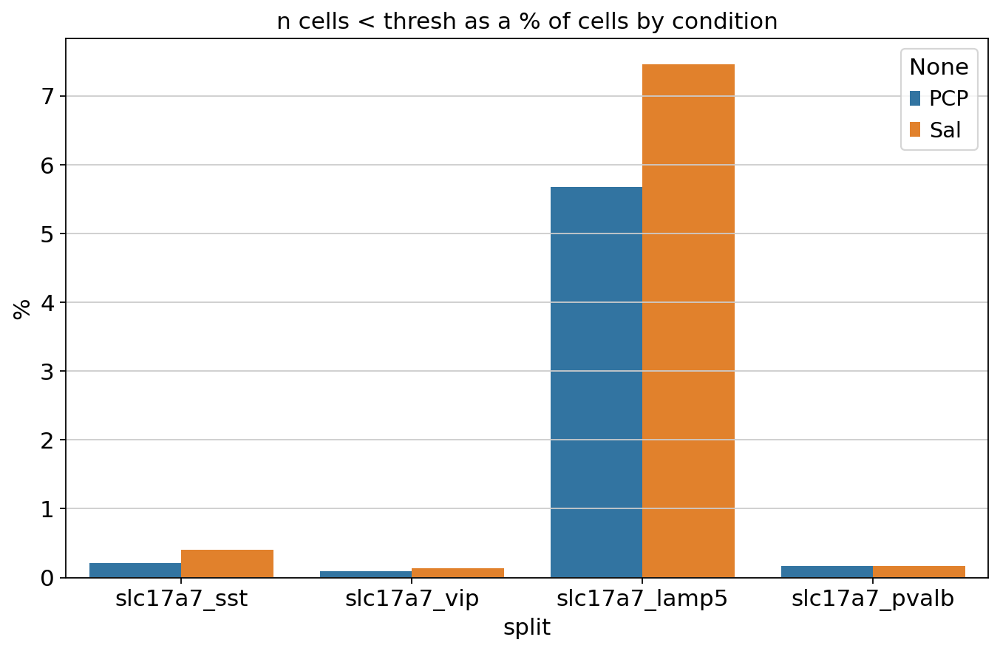

In [944]:
sns.barplot(new_df, x = 'split', y='%', hue = new_df.index)
plt.title('n cells < thresh as a % of cells by condition')
plt.show()

In [945]:
#look at co-expression by cluster -> coarsse

#dic -> region -> glu/gaba -> gene -> % vec
dic = {}
for curr_reg in subdata.obs['class_label'].unique():
    dic.update({curr_reg:{}})
    for curr_cell in ['GLU', 'GABA']:
        dic[curr_reg].update({curr_cell:{}})
        if curr_cell=='GLU':
            curr_l = glu_l[subdata.obs['class_label'] == curr_reg]
            curr_name = glu_name[subdata.obs['class_label'] == curr_reg]
            gene_l = glu_mark
        
        if curr_cell=='GABA':
            curr_l = gaba_l[subdata.obs['class_label'] == curr_reg]
            curr_name = gaba_name[subdata.obs['class_label'] == curr_reg]
            gene_l = gaba_mark
    
        for gene in gene_l:
            dic[curr_reg][curr_cell].update({gene:curr_l[curr_name == gene]})

In [948]:
new_df = pd.DataFrame()
reg_name,marker,norm = [],[],[]
thresh=20
tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']

for curr_reg in subdata.obs['class_name'].unique():
    sub_df = pd.DataFrame()
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_sst==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_vip==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_lamp5==True)[:,0]].obs.groupby('condition').count()['LibID']])
    sub_df = pd.concat([sub_df,subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_pvalb==True)[:,0]].obs.groupby('condition').count()['LibID']])    
    marker = np.concatenate([
        np.repeat('slc17a7_sst', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_sst == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_vip', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_vip == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_lamp5', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_lamp5 == True)[:, 0]].obs.groupby('condition').count()['LibID'])),
        np.repeat('slc17a7_pvalb', len(subdata[(subdata.obs['class_name'] == curr_reg).values & (slc17a7_pvalb == True)[:, 0]].obs.groupby('condition').count()['LibID']))
    ])
    sub_df['set'] = np.ravel(marker)
    sub_df['class'] = np.repeat(curr_reg,len(sub_df))

    new_df = pd.concat([new_df,sub_df])

new_df.rename(columns={'LibID':'n_cells'}, inplace=True)
new_df['condition'] = new_df.index
new_df['%'] = new_df['n_cells']

new_df.loc[new_df['condition'] == 'PCP', '%'] = new_df.loc[new_df['condition'] == 'PCP', '%'] / tot_pcp
new_df.loc[new_df['condition'] == 'Sal', '%'] = new_df.loc[new_df['condition'] == 'Sal', '%'] / tot_sal


/tmp/ipykernel_3437533/1278920207.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
/tmp/ipykernel_3437533/1278920207.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']
/tmp/ipykernel_3437533/1278920207.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sub_df = pd.concat([sub_df,subda

In [951]:
new_df

,n_cells,set,class,condition,%
PCP,19.0,slc17a7_sst,02 NP-CT-L6b Glut,PCP,0.000454
Sal,57.0,slc17a7_sst,02 NP-CT-L6b Glut,Sal,0.001345
PCP,6.0,slc17a7_vip,02 NP-CT-L6b Glut,PCP,0.000143
Sal,18.0,slc17a7_vip,02 NP-CT-L6b Glut,Sal,0.000425
PCP,96.0,slc17a7_lamp5,02 NP-CT-L6b Glut,PCP,0.002295
Sal,159.0,slc17a7_lamp5,02 NP-CT-L6b Glut,Sal,0.003751
PCP,23.0,slc17a7_pvalb,02 NP-CT-L6b Glut,PCP,0.000550
Sal,23.0,slc17a7_pvalb,02 NP-CT-L6b Glut,Sal,0.000543
PCP,45.0,slc17a7_sst,01 IT-ET Glut,PCP,0.001076
Sal,90.0,slc17a7_sst,01 IT-ET Glut,Sal,0.002123


In [957]:
new_df.groupby(['class', 'set'])['n_cells'].sum()

class              set          
01 IT-ET Glut      slc17a7_lamp5    5247.0
                   slc17a7_pvalb      84.0
                   slc17a7_sst       135.0
                   slc17a7_vip        63.0
02 NP-CT-L6b Glut  slc17a7_lamp5     255.0
                   slc17a7_pvalb      46.0
                   slc17a7_sst        76.0
                   slc17a7_vip        24.0
06 CTX-CGE GABA    slc17a7_lamp5      12.0
                   slc17a7_vip         9.0
07 CTX-MGE GABA    slc17a7_lamp5      16.0
                   slc17a7_pvalb       9.0
                   slc17a7_sst        37.0
                   slc17a7_vip         1.0
08 CNU-MGE GABA    slc17a7_lamp5       3.0
                   slc17a7_sst        11.0
10 LSX GABA        slc17a7_lamp5       2.0
                   slc17a7_sst         2.0
Name: n_cells, dtype: float64

In [964]:
#now sum over PCP saline for totals
curr = pd.DataFrame(new_df.groupby(['class', 'set'])['n_cells'].sum())
curr['%'] = (curr.values[:,0] / subdata.obs.groupby('class_name').count()['LibID'].loc[np.asarray([i[0] for i in curr.index])].values)*100  # % of that cluster that pass threshold
curr

/tmp/ipykernel_3437533/2595466036.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  curr['%'] = (curr.values[:,0] / subdata.obs.groupby('class_name').count()['LibID'].loc[np.asarray([i[0] for i in curr.index])].values)*100  # % of that cluster that pass threshold


n_cells          %
class             set                              
01 IT-ET Glut     slc17a7_lamp5   5247.0  11.145570
                  slc17a7_pvalb     84.0   0.178431
                  slc17a7_sst      135.0   0.286764
                  slc17a7_vip       63.0   0.133823
02 NP-CT-L6b Glut slc17a7_lamp5    255.0   1.056338
                  slc17a7_pvalb     46.0   0.190555
                  slc17a7_sst       76.0   0.314830
                  slc17a7_vip       24.0   0.099420
06 CTX-CGE GABA   slc17a7_lamp5     12.0   0.356189
                  slc17a7_vip        9.0   0.267142
07 CTX-MGE GABA   slc17a7_lamp5     16.0   0.179957
                  slc17a7_pvalb      9.0   0.101226
                  slc17a7_sst       37.0   0.416151
                  slc17a7_vip        1.0   0.011247
08 CNU-MGE GABA   slc17a7_lamp5      3.0   1.107011
                  slc17a7_sst       11.0   4.059041
10 LSX GABA       slc17a7_lamp5      2.0   0.701754
                  slc17a7_sst        2.0   0.701754

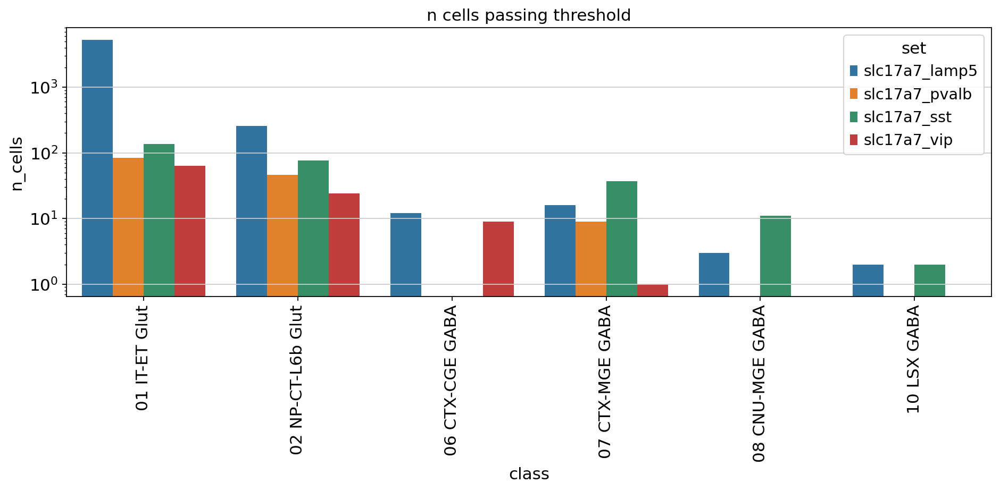

In [962]:
curr = pd.DataFrame(curr)

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='set')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)
plt.yscale('log')
# Show the plot
plt.tight_layout()
plt.show()

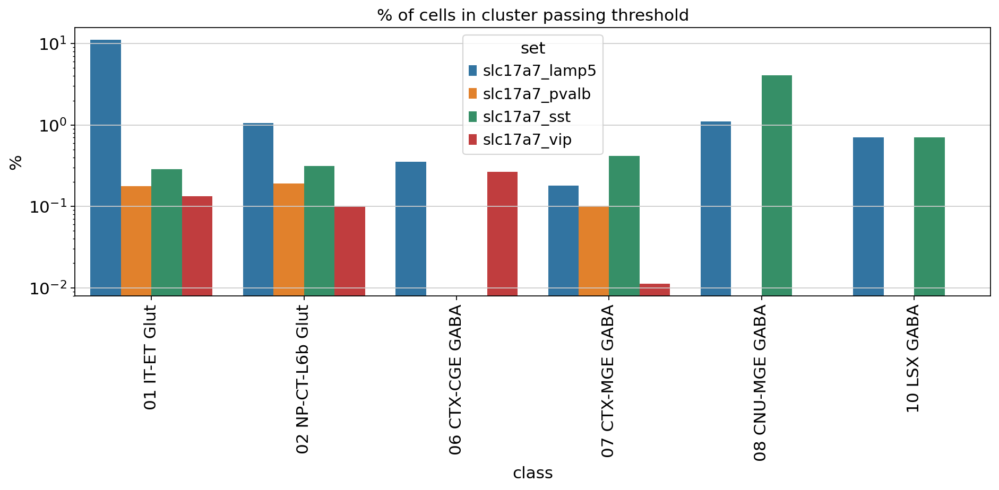

In [966]:
curr = pd.DataFrame(curr)

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%', hue='set')
plt.title('% of cells in cluster passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)
plt.yscale('log')
# Show the plot
plt.tight_layout()
plt.show()

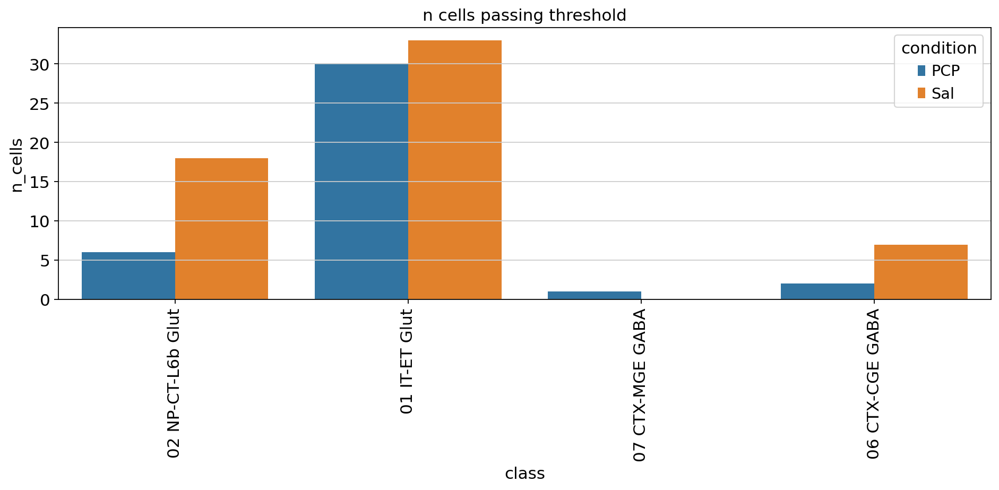

In [969]:
curr = new_df[new_df['set']=='slc17a7_vip']

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

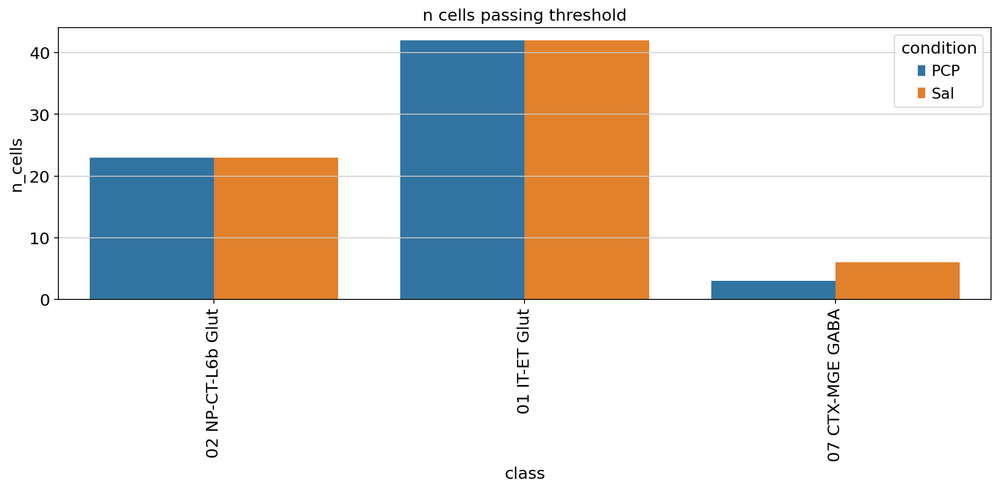

In [970]:
curr = new_df[new_df['set']=='slc17a7_pvalb']

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='n_cells', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

/tmp/ipykernel_3437533/3169854586.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']
/tmp/ipykernel_3437533/3169854586.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr['%_cluster'] = [i[0] for i in tot]


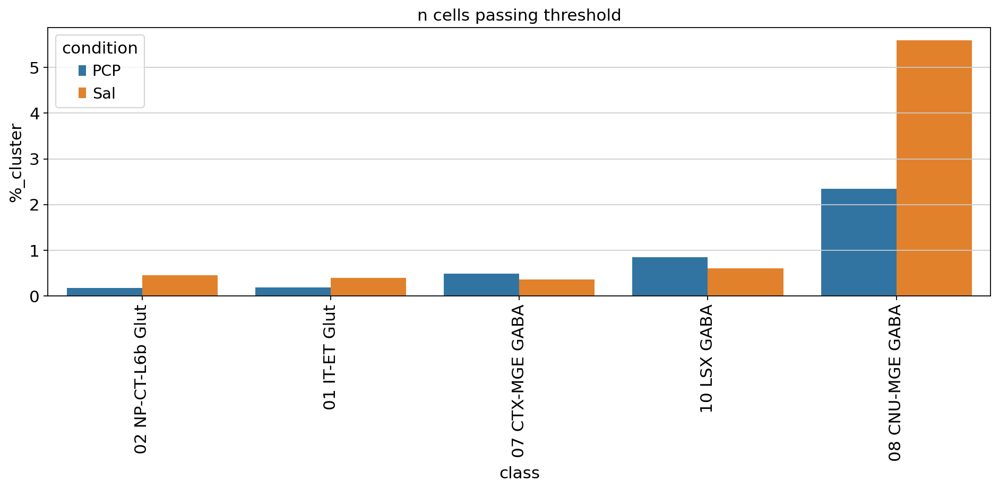

In [972]:
curr = new_df[new_df['set']=='slc17a7_sst']
curr.reset_index(drop=True, inplace=True)
#curr['%_cluster'] = (curr['n_cells'] / subdata.obs.groupby('class_name').count()['LibID'].loc[curr['class']].values)*100  # % of that cluster that pass threshold
multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%_cluster', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

/tmp/ipykernel_3437533/1265128391.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']
/tmp/ipykernel_3437533/1265128391.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr['%_cluster'] = [i[0] for i in tot]


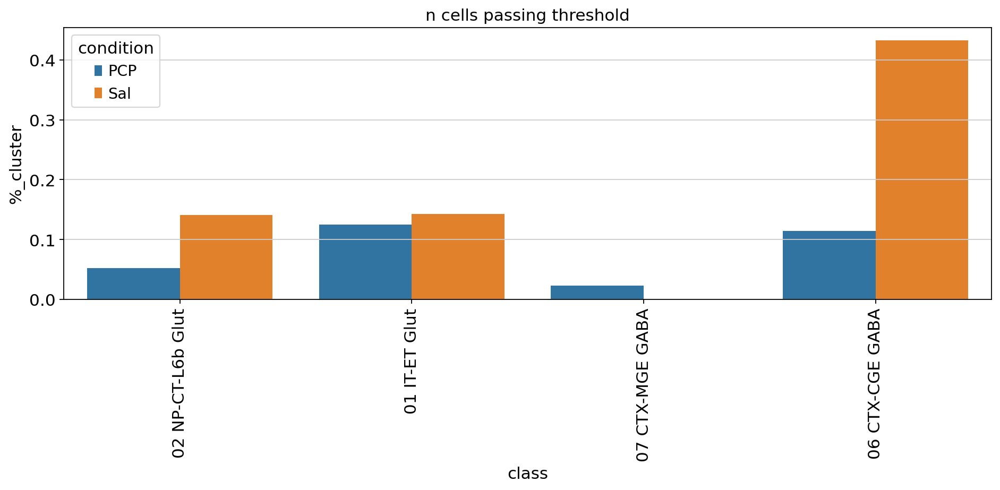

In [975]:
curr = new_df[new_df['set']=='slc17a7_vip']
curr.reset_index(drop=True, inplace=True)
#curr['%_cluster'] = (curr['n_cells'] / subdata.obs.groupby('class_name').count()['LibID'].loc[curr['class']].values)*100  # % of that cluster that pass threshold
multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%_cluster', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

/tmp/ipykernel_3437533/3367796444.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']
/tmp/ipykernel_3437533/3367796444.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr['%_cluster'] = [i[0] for i in tot]


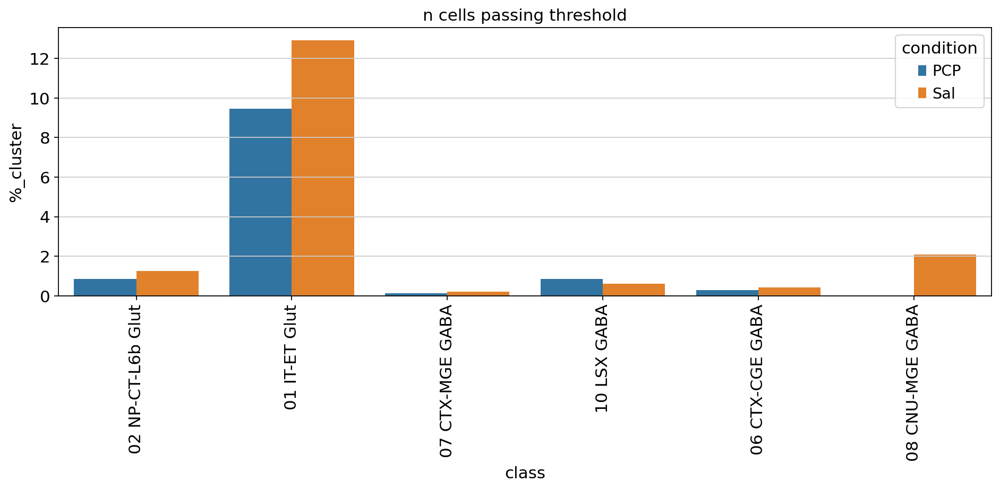

In [976]:
curr = new_df[new_df['set']=='slc17a7_lamp5']
curr.reset_index(drop=True, inplace=True)
#curr['%_cluster'] = (curr['n_cells'] / subdata.obs.groupby('class_name').count()['LibID'].loc[curr['class']].values)*100  # % of that cluster that pass threshold
multi = subdata.obs.groupby(['class_name', 'condition']).count()['LibID']

tot = []
for row in range(len(curr)):
    reg = curr.loc[row]['class']
    cond = curr.loc[row]['condition']
    tot.append(((curr[(curr['class']==reg) & (curr['condition']==cond)]['n_cells'].values / (multi[reg][cond]))*100))
curr['%_cluster'] = [i[0] for i in tot]

# Plot using sns.barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=curr, x='class', y='%_cluster', hue='condition')
plt.title('n cells passing threshold')

# Rotate x-axis tick labels to 90 degrees
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

In [862]:
#load in filtered neuron + glia 
subdata = sc.read_h5ad(out_path + 'KIBM_adata_processed-filtered-subset.h5ad')

In [863]:
subdata

AnnData object with n_obs × n_vars = 105052 × 3511
    obs: 'LibID', 'Sample', 'n_genes', 'n_counts', 'class_name', 'subclass_name', 'supertype_name', 'cluster_name', 'is_ctx_neuron', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'doublet_score', 'predicted_doublet', 'class_label', 'subclass_label', 'supertype_label', 'cluster_label', 'condition', 'leiden'
    var: 'gene', 'genetype', 'n_counts', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'class_label_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'scruble

In [865]:
#refine cluster labels
gaba_mark = ['Gad2', 'Gad1','Slc32a1', 'Sst', 'Pvalb', 'Lamp5', 'Vip']
glu_mark = ['Slc17a7', 'Slc17a6']
astro_mark = ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4', 'Glul']
oli_mark = ['Mbp', 'Mog', 'Cnp', 'Plp1','Sox10', 'Olig2', 'Olig1']
mi_mark = ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
comb_l = gaba_mark+glu_mark+astro_mark+oli_mark+mi_mark


Gaba: ['Gad2', 'Gad1', 'Slc32a1', 'Sst', 'Pvalb', 'Lamp5', 'Vip']
Glu: ['Slc17a7', 'Slc17a6']


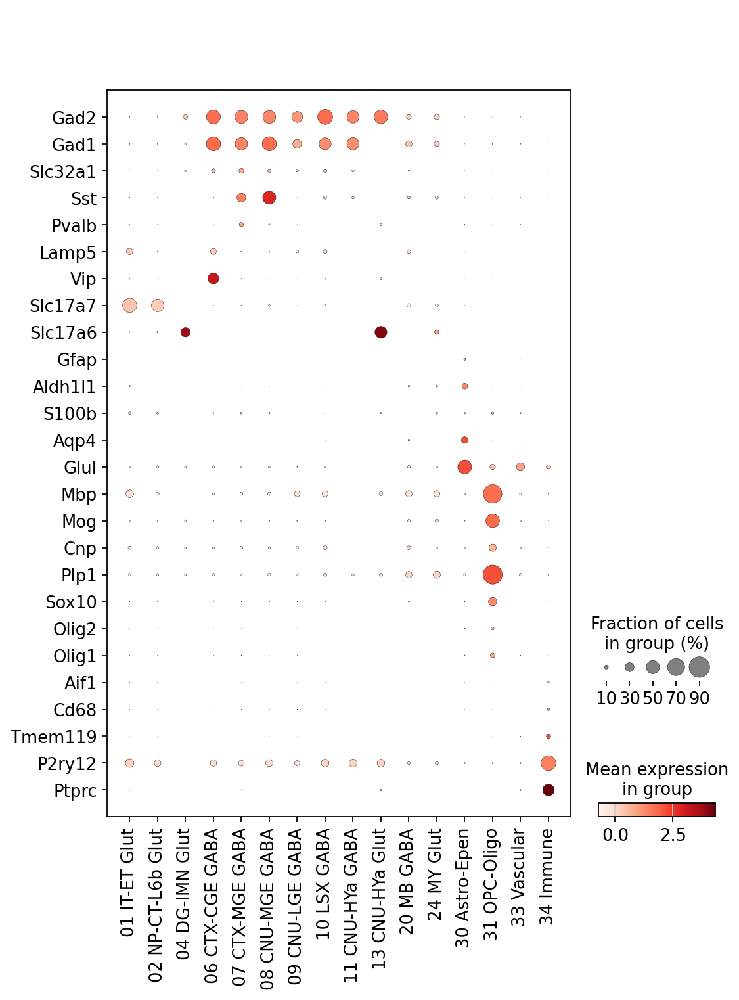

In [866]:
name_l = ['Gaba','Glu', 'Astro', 'Oligo', 'Micro']
for x,i in enumerate(print_l):print(f'{name_l[x]}: {i}')
subdata.var.index = subdata.var['gene'].astype(str)
subdata.var_names_make_unique()

#Dotplot of gene expression by
sc.pl.dotplot(subdata,var_names=list(comb_l),
              groupby='class_name',swap_axes=True, use_raw=False)

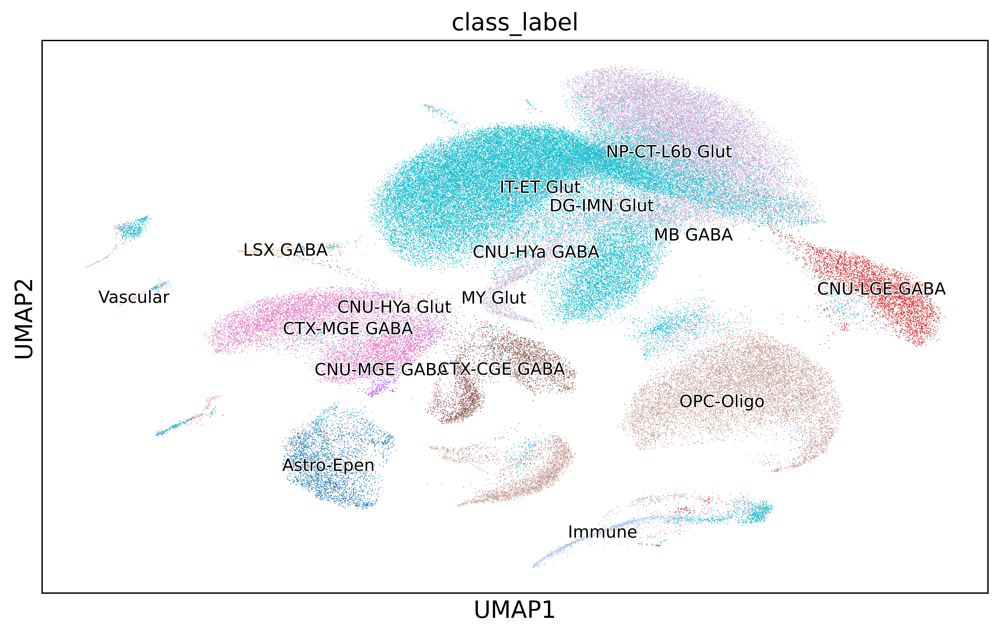

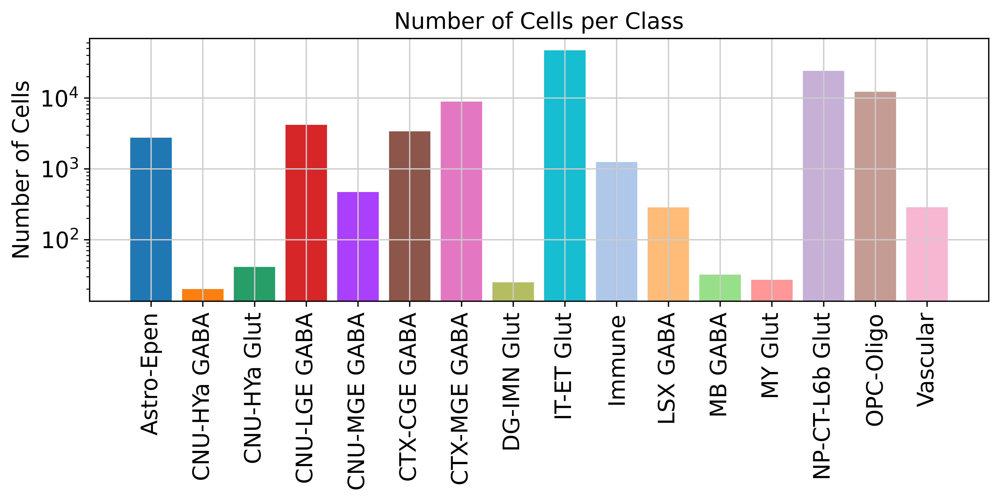

In [868]:
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(subdata,color=['class_label'],legend_loc='on data',
           legend_fontsize=10,legend_fontweight='normal',legend_fontoutline=1)


# Create a bar plot with the same colors
fig, ax = plt.subplots(figsize=(10, 3))
class_label_colors = dict(zip(subdata.obs['class_label'].cat.categories, subdata.uns['class_label_colors']))
cluster_counts = subdata.obs['class_label'].value_counts()

# Sort the clusters
cluster_counts = cluster_counts.sort_index()

# Create the bar plot
bars = ax.bar(cluster_counts.index, cluster_counts.values, color=[class_label_colors[label] for label in cluster_counts.index])

# Set labels and title
plt.ylabel('Number of Cells')
plt.title('Number of Cells per Class')
plt.yscale('log')
plt.xticks(rotation=90)

# Show the plot
plt.show()

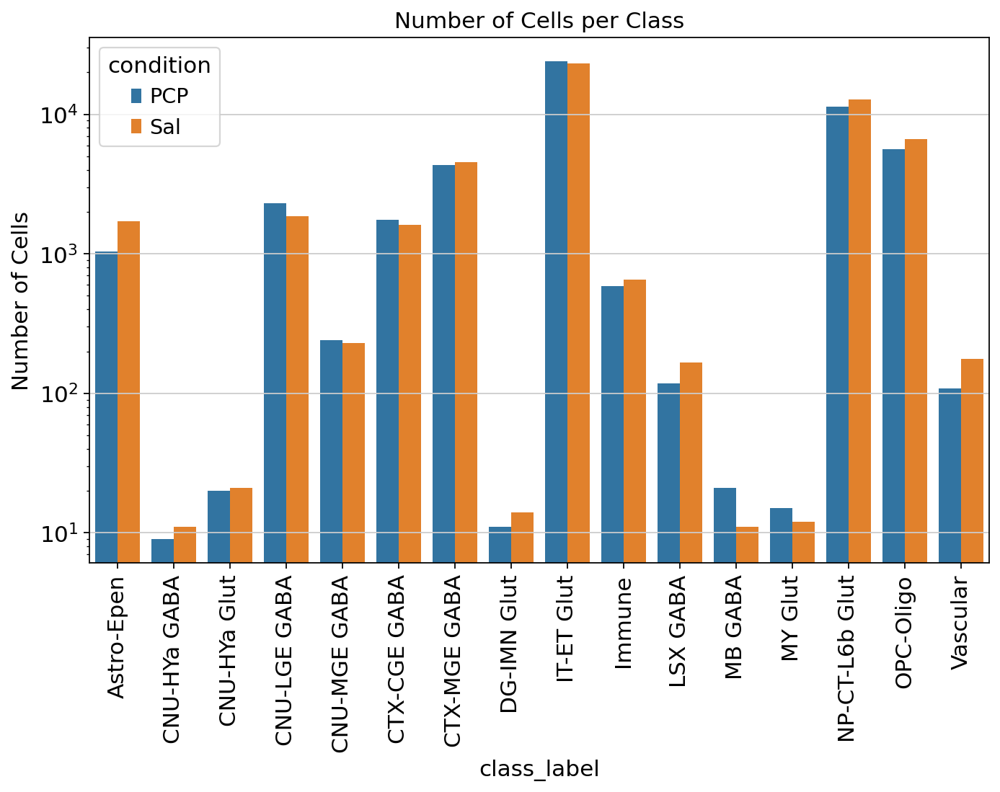

In [880]:
cluster_counts = subdata.obs[['class_label','condition']].value_counts()
cluster_counts = pd.DataFrame(cluster_counts.sort_index())


# Create the bar plot
sns.barplot(data = cluster_counts, x = 'class_label', y ='count' , hue = 'condition')

# Set labels and title
plt.ylabel('Number of Cells')
plt.title('Number of Cells per Class')
plt.yscale('log')
plt.xticks(rotation=90)

# Show the plot
plt.show()

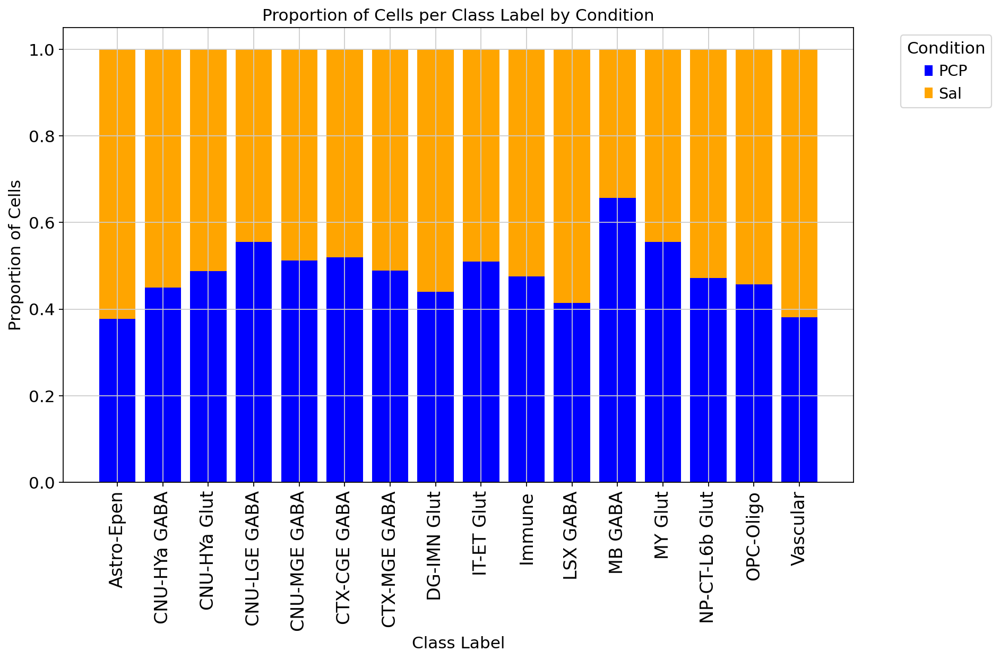

In [869]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

sc.set_figure_params(figsize=(10, 6))

# Create a contingency table with counts of each condition (PCP or saline) for each class_label
contingency_table = pd.crosstab(subdata.obs['class_label'], subdata.obs['condition'])

# Normalize by the total number of cells in each class_label to get proportions
proportion_table = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Extract the color palette for conditions (assuming two conditions: 'PCP' and 'saline')
condition_colors = {'PCP': 'blue', 'Sal': 'orange'}

# Generate the stacked bar plot
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each condition as a separate bar segment
bottom = pd.Series([0] * len(proportion_table), index=proportion_table.index)
for condition in proportion_table.columns:
    values = proportion_table[condition]
    ax.bar(proportion_table.index, values, bottom=bottom, color=condition_colors[condition], label=condition)
    bottom += values

# Rotate the x-axis labels by 90 degrees and set font size smaller
plt.xticks(rotation=90, fontsize=15)

# Set labels and title for the bar plot
ax.set_ylabel('Proportion of Cells')
ax.set_xlabel('Class Label')
ax.set_title('Proportion of Cells per Class Label by Condition')
ax.legend(title='Condition', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()

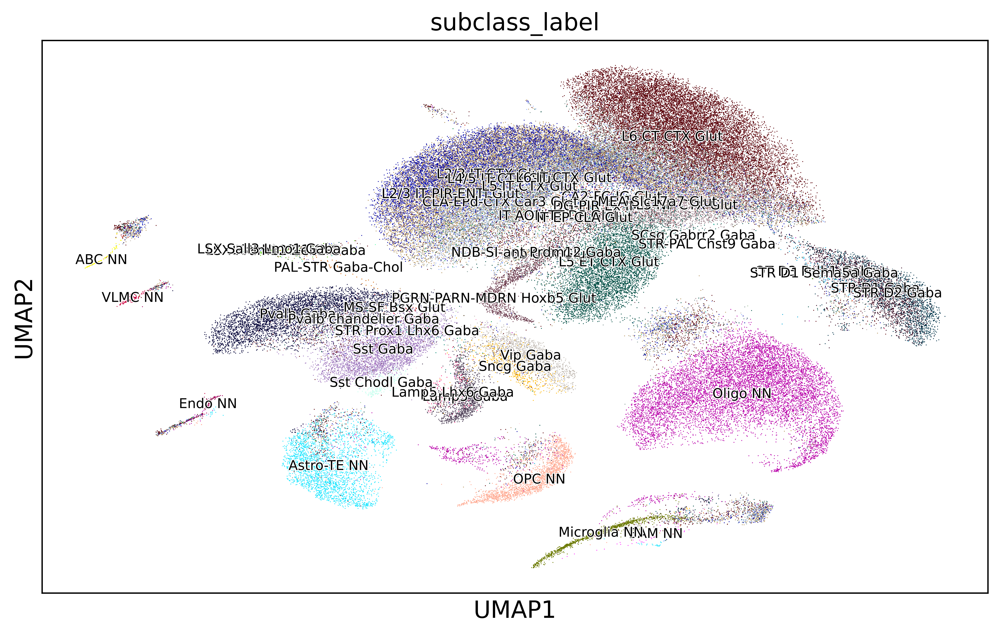

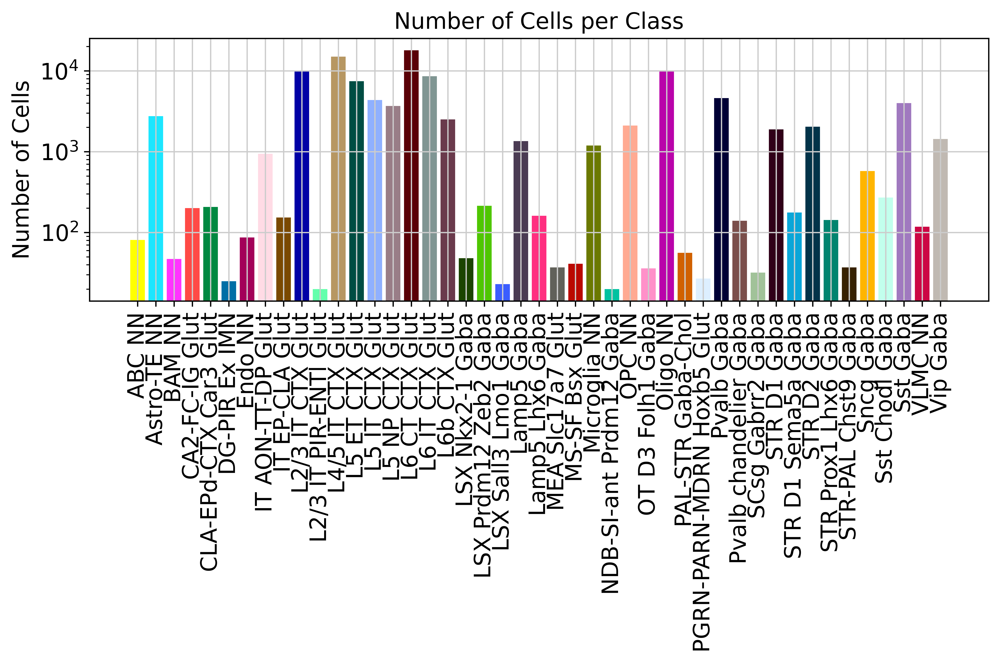

In [881]:
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(subdata,color=['subclass_label'],legend_loc='on data',
           legend_fontsize=8,legend_fontweight='normal',legend_fontoutline=1)


# Create a bar plot with the same colors
fig, ax = plt.subplots(figsize=(10, 3))
class_label_colors = dict(zip(subdata.obs['subclass_label'].cat.categories, subdata.uns['subclass_label_colors']))
cluster_counts = subdata.obs['subclass_label'].value_counts()

# Sort the clusters
cluster_counts = cluster_counts.sort_index()

# Create the bar plot
bars = ax.bar(cluster_counts.index, cluster_counts.values, color=[class_label_colors[label] for label in cluster_counts.index])

# Set labels and title
plt.ylabel('Number of Cells')
plt.title('Number of Cells per Class')
plt.yscale('log')
plt.xticks(rotation=90)

# Show the plot
plt.show()

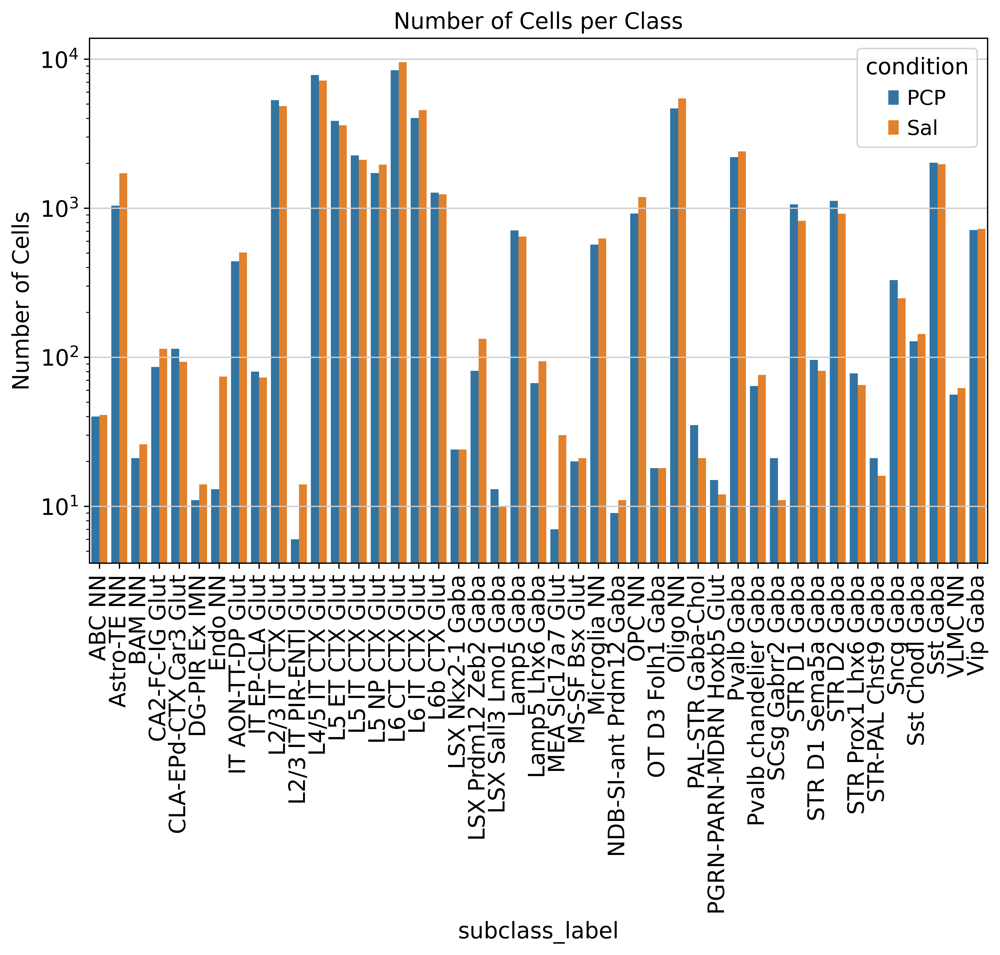

In [882]:
cluster_counts = subdata.obs[['subclass_label','condition']].value_counts()
cluster_counts = pd.DataFrame(cluster_counts.sort_index())


# Create the bar plot
sns.barplot(data = cluster_counts, x = 'subclass_label', y ='count' , hue = 'condition')

# Set labels and title
plt.ylabel('Number of Cells')
plt.title('Number of Cells per Class')
plt.yscale('log')
plt.xticks(rotation=90)

# Show the plot
plt.show()

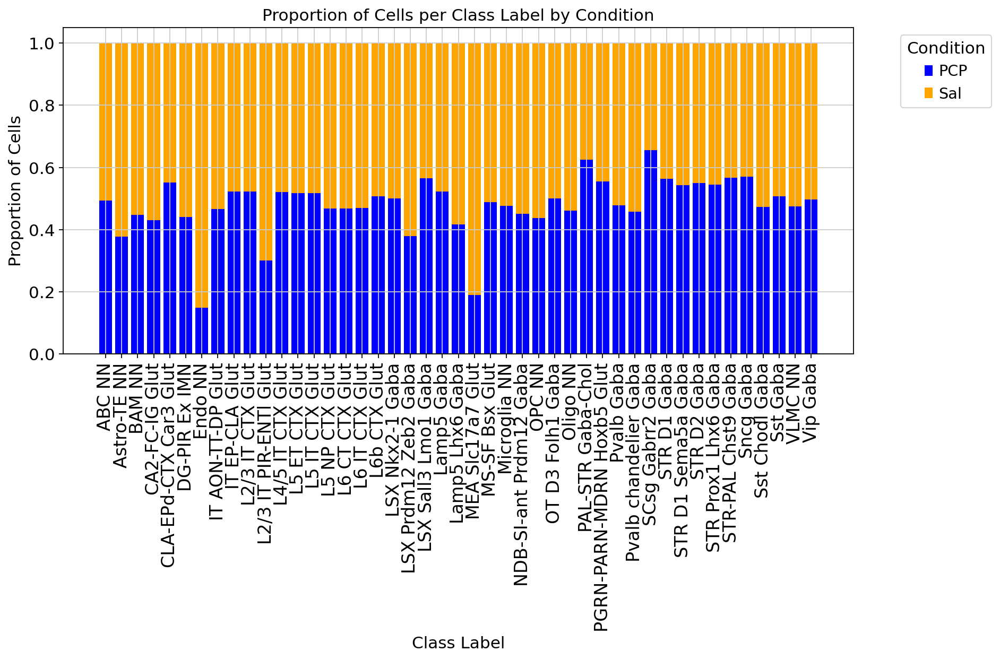

In [883]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd

sc.set_figure_params(figsize=(10, 6))

# Create a contingency table with counts of each condition (PCP or saline) for each class_label
contingency_table = pd.crosstab(subdata.obs['subclass_label'], subdata.obs['condition'])

# Normalize by the total number of cells in each class_label to get proportions
proportion_table = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Extract the color palette for conditions (assuming two conditions: 'PCP' and 'saline')
condition_colors = {'PCP': 'blue', 'Sal': 'orange'}

# Generate the stacked bar plot
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each condition as a separate bar segment
bottom = pd.Series([0] * len(proportion_table), index=proportion_table.index)
for condition in proportion_table.columns:
    values = proportion_table[condition]
    ax.bar(proportion_table.index, values, bottom=bottom, color=condition_colors[condition], label=condition)
    bottom += values

# Rotate the x-axis labels by 90 degrees and set font size smaller
plt.xticks(rotation=90, fontsize=15)

# Set labels and title for the bar plot
ax.set_ylabel('Proportion of Cells')
ax.set_xlabel('Class Label')
ax.set_title('Proportion of Cells per Class Label by Condition')
ax.legend(title='Condition', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()

In [1017]:
%autoreload
#GLU VS astro
#refine cluster labels
gaba_mark = ['Gad2', 'Gad1','Slc32a1']
glu_mark = ['Slc17a7', 'Slc17a6']
astro_mark = ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4', 'Glul']
oli_mark = ['Mbp', 'Mog', 'Cnp', 'Plp1','Sox10', 'Olig2', 'Olig1']
mi_mark = ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
comb_l = gaba_mark+glu_mark+astro_mark+oli_mark+mi_mark

data = subdata.X
names = subdata.var['gene']
glu_name, glu_rank= pf.rank_genes(data=data, names=names, mark_l =  glu_mark)
gaba_name, gaba_rank= pf.rank_genes(data=data, names=names, mark_l =  gaba_mark)
astro_name, astro_rank= pf.rank_genes(data=data, names=names, mark_l =  astro_mark)
mi_name, mi_rank= pf.rank_genes(data=data, names=names, mark_l =  mi_mark)
oli_name, oli_rank= pf.rank_genes(data=data, names=names, mark_l =  oli_mark)

0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942
0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942
0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942
0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942
0.0
9.999525019592943
19.999050039185885
29.998575058778826
39.99810007837177
49.99762509796471
59.99715011755765
69.99667513715059
79.99620015674354
89.99572517633648
99.99525019592942


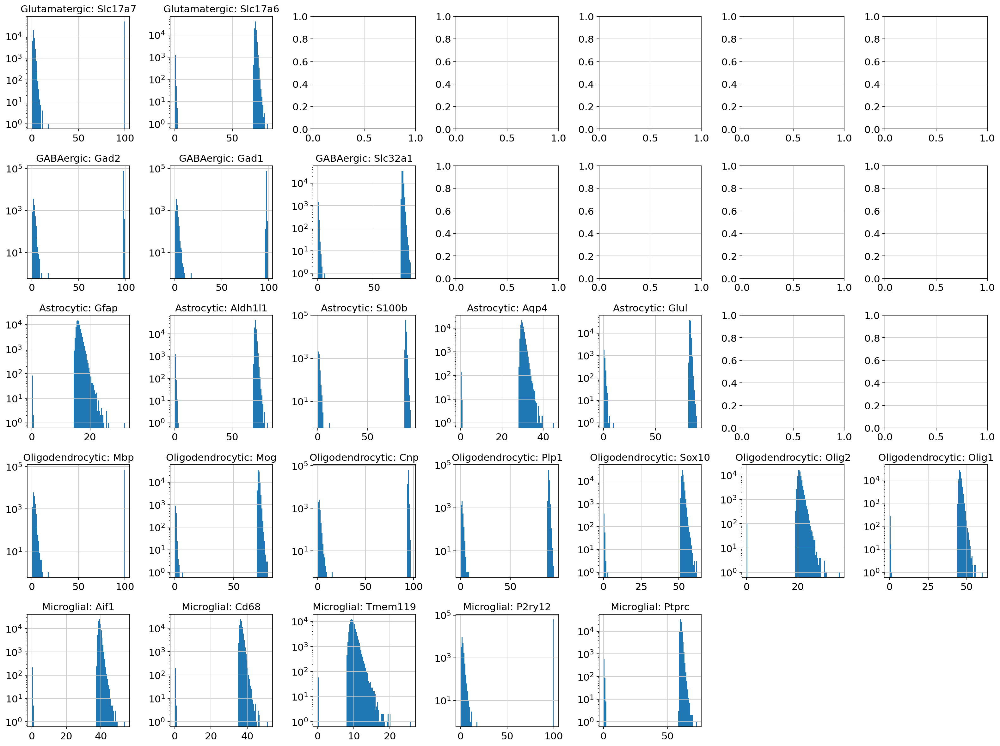

In [1036]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming rank_l, glu_l, and gaba_l are already defined
# List of gene names and titles
genes_l = [glu_mark, gaba_mark, astro_mark, oli_mark, mi_mark]
titles = ["Glutamatergic", "GABAergic", "Astrocytic", "Oligodendrocytic", "Microglial"]
data_l = [[glu_name, glu_rank], [gaba_name, gaba_rank], [astro_name, astro_rank], [oli_name, oli_rank], [mi_name, mi_rank]]

# Create a figure and a set of subplots
fig, axs = plt.subplots(5, 7, figsize=(20, 15))  # 5 rows and 7 columns

# Loop through each gene and create the corresponding subplot
for i, curr in enumerate(genes_l):
    for j, gene in enumerate(curr):
        curr_name = data_l[i][0]
        curr_rank = data_l[i][1]
        dist = np.asarray([curr_rank[k][np.where(curr_name[k] == gene)] for k in range(len(curr_name))]).flatten()
        
        axs[i, j].hist(dist, bins=100)
        axs[i, j].set_yscale('log')
        axs[i, j].set_title(f"{titles[i]}: {gene}")

# Hide any unused subplots
for i in range(len(genes_l), axs.shape[0]):
    for j in range(axs.shape[1]):
        fig.delaxes(axs[i, j])
for j in range(len(genes_l[-1]), axs.shape[1]):
    fig.delaxes(axs[len(genes_l)-1, j])

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()


In [1037]:
#get vectors for each marker
slc17a7 = np.asarray([glu_rank[j][np.where(glu_name[j]=='Slc17a7')] for j in range(len(glu_rank))])
gad1 = np.asarray([gaba_rank[j][np.where(gaba_name[j]=='Gad1')] for j in range(len(gaba_rank))])
gad2 = np.asarray([gaba_rank[j][np.where(gaba_name[j]=='Gad2')] for j in range(len(gaba_rank))])
gfap = np.asarray([astro_rank[j][np.where(astro_name[j]=='Gfap')] for j in range(len(astro_rank))])
aldh1l1 = np.asarray([astro_rank[j][np.where(astro_name[j]=='Aldh1l1')] for j in range(len(astro_rank))])
s100b = np.asarray([astro_rank[j][np.where(astro_name[j]=='S100b')] for j in range(len(astro_rank))])
mbp = np.asarray([oli_rank[j][np.where(oli_name[j]=='Mbp')] for j in range(len(oli_rank))])
mog = np.asarray([oli_rank[j][np.where(oli_name[j]=='Mop')] for j in range(len(oli_rank))])
cnp = np.asarray([oli_rank[j][np.where(oli_name[j]=='Cnp')] for j in range(len(oli_rank))])
aif1 = np.asarray([mi_rank[j][np.where(mi_name[j]=='Aif1')] for j in range(len(mi_rank))])
cd68 = np.asarray([mi_rank[j][np.where(mi_name[j]=='Cd68')] for j in range(len(mi_rank))])

In [1038]:
#GLU vs glia
thresh_l = np.arange(0, 105, 5)

# Initialize lists to store results
results = {
    'slc17a7_gfap': [],
    'slc17a7_aldh1l1': [],
    'slc17a7_s100b': [],
    'slc17a7_mbp': [],
    'slc17a7_mog': [],
    'slc17a7_cnp': [],
    'slc17a7_aif1': [],
    'slc17a7_cd68': [],
    'slc17a7_astro': [],
    'slc17a7_oli': [],
    'slc17a7_mi': []
}

for thresh in thresh_l:
    results['slc17a7_gfap'].append(sum((slc17a7 < thresh) & (gfap < thresh)))
    results['slc17a7_aldh1l1'].append(sum((slc17a7 < thresh) & (aldh1l1 < thresh)))
    results['slc17a7_s100b'].append(sum((slc17a7 < thresh) & (s100b < thresh)))
    results['slc17a7_mbp'].append(sum((slc17a7 < thresh) & (mbp < thresh)))
    results['slc17a7_mog'].append(sum((slc17a7 < thresh) & (mog < thresh)))
    results['slc17a7_cnp'].append(sum((slc17a7 < thresh) & (cnp < thresh)))
    results['slc17a7_aif1'].append(sum((slc17a7 < thresh) & (aif1 < thresh)))
    results['slc17a7_cd68'].append(sum((slc17a7 < thresh) & (cd68 < thresh)))
    
    results['slc17a7_astro'].append(sum((slc17a7 < thresh) & (gfap < thresh) & (aldh1l1 < thresh) & (s100b < thresh)))
    results['slc17a7_oli'].append(sum((slc17a7 < thresh) & (mbp < thresh) & (mog < thresh) & (cnp < thresh)))
    results['slc17a7_mi'].append(sum((slc17a7 < thresh) & (aif1 < thresh) & (cd68 < thresh)))


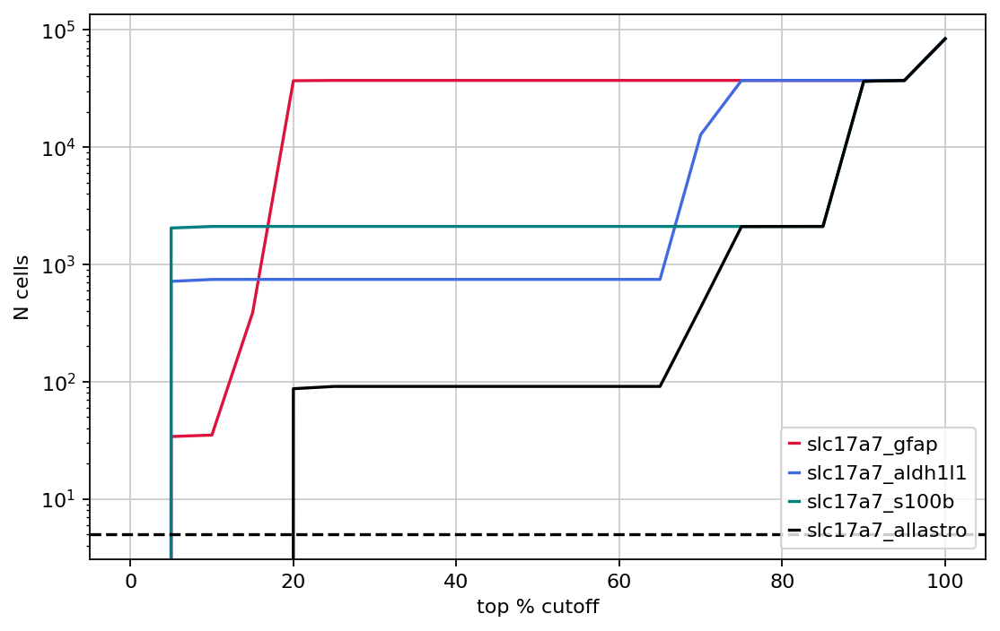

In [1040]:
#GLU vs astro
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(8,5))
plt.plot(thresh_l, results['slc17a7_gfap'], label = 'slc17a7_gfap', c='crimson')
plt.plot(thresh_l, results['slc17a7_aldh1l1'], label = 'slc17a7_aldh1l1', c='royalblue')
plt.plot(thresh_l, results['slc17a7_s100b'], label = 'slc17a7_s100b', c='teal')
plt.plot(thresh_l, results['slc17a7_astro'], label = 'slc17a7_allastro', c='k')

#plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
plt.savefig('prac.svg')
plt.show()

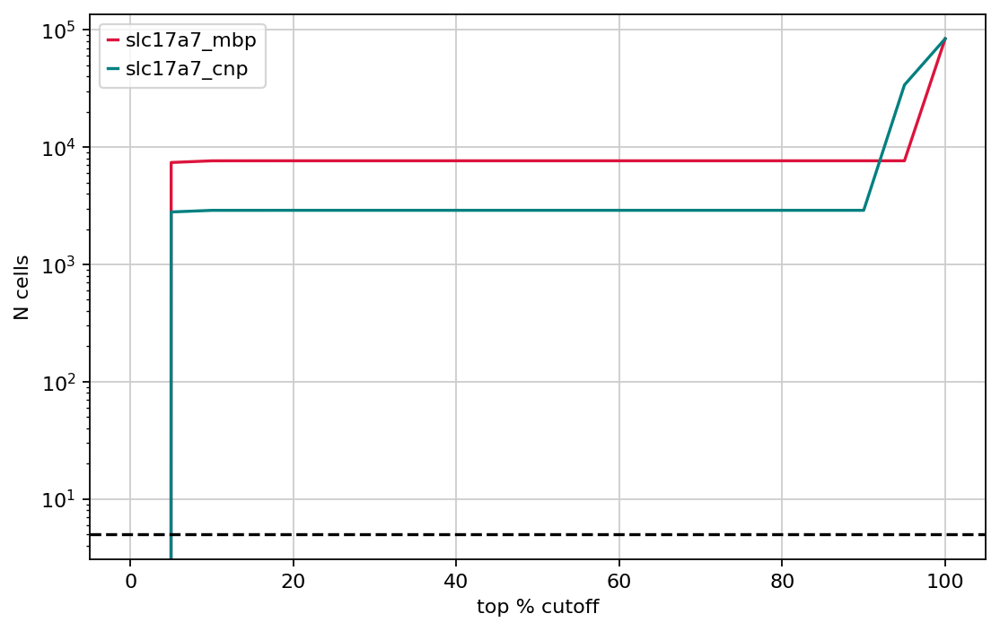

In [1041]:
#GLU vs oli
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(8,5))
plt.plot(thresh_l, results['slc17a7_mbp'], label = 'slc17a7_mbp', c='crimson')
plt.plot(thresh_l, results['slc17a7_mog'], label = 'slc17a7_mog', c='royalblue')
plt.plot(thresh_l, results['slc17a7_cnp'], label = 'slc17a7_cnp', c='teal')
plt.plot(thresh_l, results['slc17a7_oli'], label = 'slc17a7_alloli', c='k')

#plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
#plt.savefig('prac.svg')
plt.show()

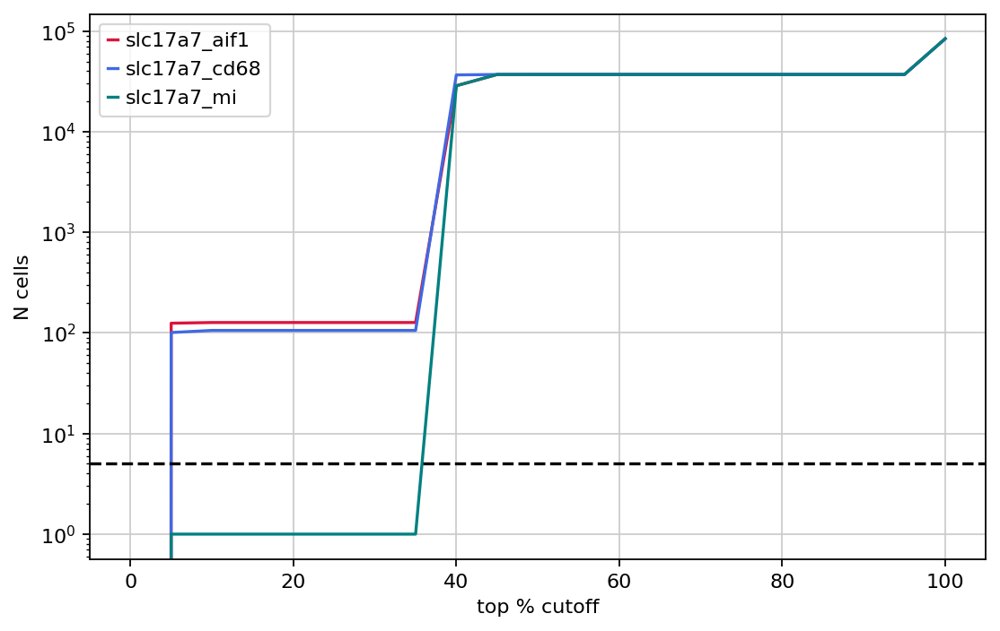

In [1042]:
#GLU vs mi
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(8,5))
plt.plot(thresh_l, results['slc17a7_aif1'], label = 'slc17a7_aif1', c='crimson')
plt.plot(thresh_l, results['slc17a7_cd68'], label = 'slc17a7_cd68', c='royalblue')
plt.plot(thresh_l, results['slc17a7_mi'], label = 'slc17a7_mi', c='teal')

#plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
#plt.savefig('prac.svg')
plt.show()

In [1045]:
#GLU vs glia
thresh = 20

#PCP vs saline
slc17a7_astro = (slc17a7 < thresh) & (gfap < thresh) & (aldh1l1 < thresh) & (s100b < thresh)
slc17a7_aif1 = (slc17a7 < thresh) & (aif1<thresh)
slc17a7_cd68 = (slc17a7 < thresh) & (cd68<thresh)

new_df = pd.DataFrame()
new_df = pd.concat([new_df,subdata[slc17a7_astro].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_aif1].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[slc17a7_cd68].obs.groupby('condition').count()['LibID']])
new_df.rename(columns={'LibID':'counts'}, inplace=True)
new_df['%'] = (new_df['counts'] / np.tile(subdata.obs.groupby('condition').count()['LibID'].values,3)) * 100
new_df['split'] = ['slc17a7_astro','slc17a7_astro','slc17a7_aif1','slc17a7_aif1','slc17a7_cd68','slc17a7_cd68']

/tmp/ipykernel_3437533/541809154.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_df = pd.concat([new_df,subdata[slc17a7_astro].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/541809154.py:10: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  new_df = pd.concat([new_df,subdata[slc17a7_astro].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/541809154.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to ado

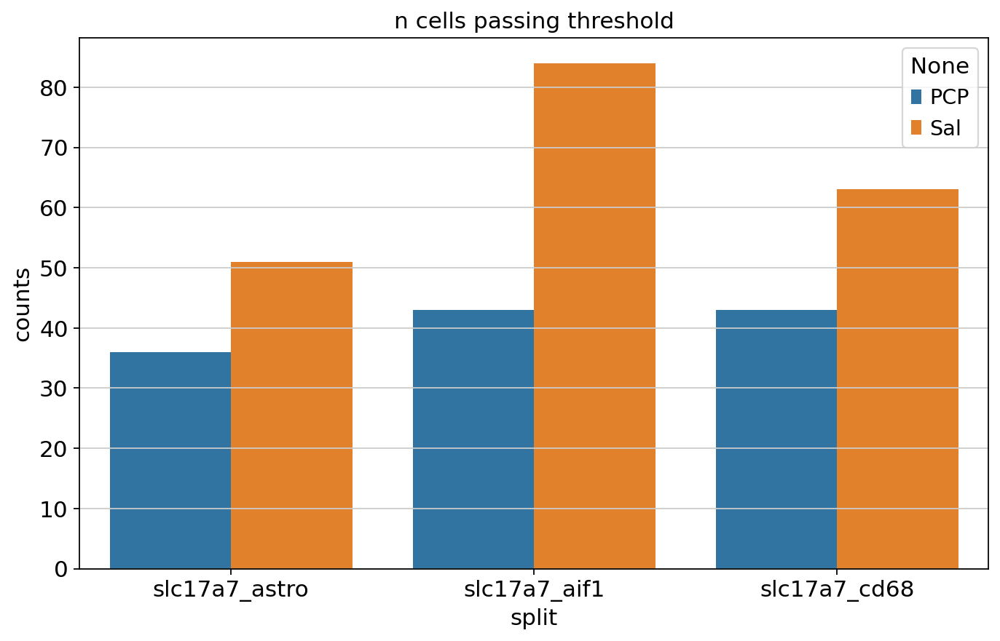

In [1049]:
sns.barplot(new_df, x = 'split', y='counts', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()

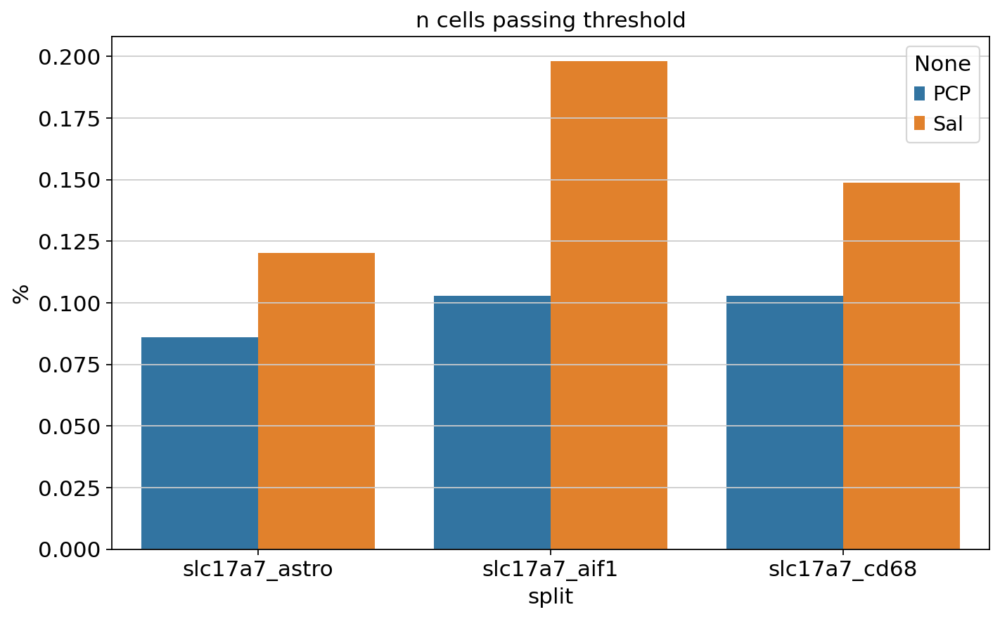

In [1050]:
sns.barplot(new_df, x = 'split', y='%', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()

In [1051]:
#ncells crossing one or the other by condition
thresh=20
slc17a7_ = (slc17a7 < thresh)
aif1_ = (aif1<thresh)
cd68_ = (cd68<thresh)
astro_ =  (gfap < thresh) & (aldh1l1 < thresh) & (s100b < thresh)


new_df = pd.DataFrame()
new_df = pd.concat([new_df,subdata[slc17a7_].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[aif1_].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[cd68_].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df,subdata[astro_].obs.groupby('condition').count()['LibID']])
new_df.rename(columns={'LibID':'counts'}, inplace=True)
tot_pcp = subdata.obs.groupby('condition').count()['LibID']['PCP']
tot_sal = subdata.obs.groupby('condition').count()['LibID']['Sal']
new_df['%'] = (new_df['counts'] / np.tile([tot_pcp,tot_sal],4)) * 100
new_df['marker'] = ['slc17a7','slc17a7','aif1','aif1','cd68','cd68','astro', 'astro']

/tmp/ipykernel_3437533/1735901909.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_df = pd.concat([new_df,subdata[slc17a7_].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/1735901909.py:10: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  new_df = pd.concat([new_df,subdata[slc17a7_].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/1735901909.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the 

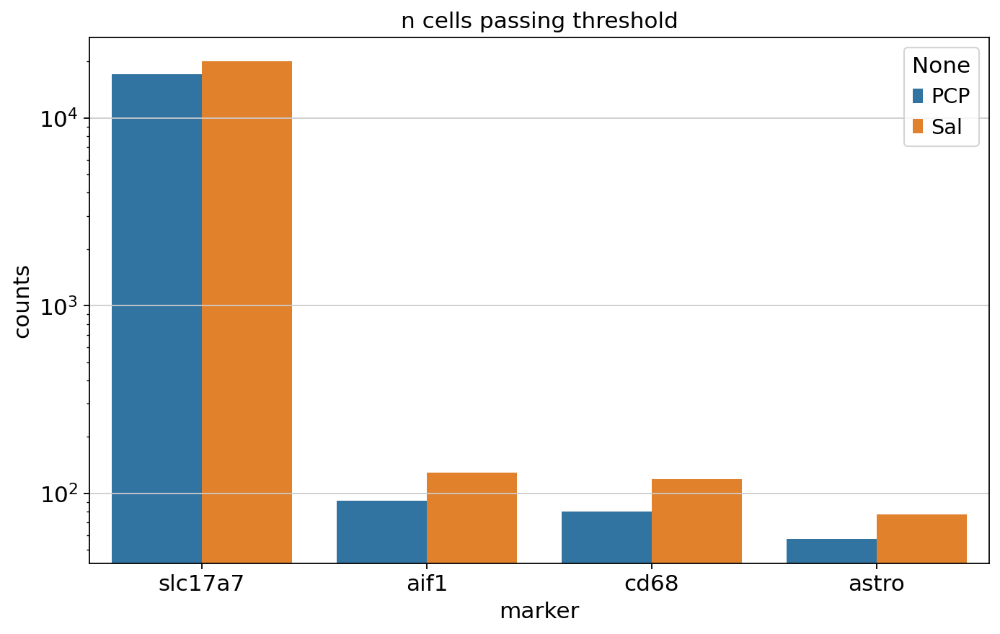

In [1053]:
sns.barplot(new_df, x = 'marker', y='counts', hue = new_df.index)
plt.title('n cells passing threshold')
plt.yscale('log')
plt.show()

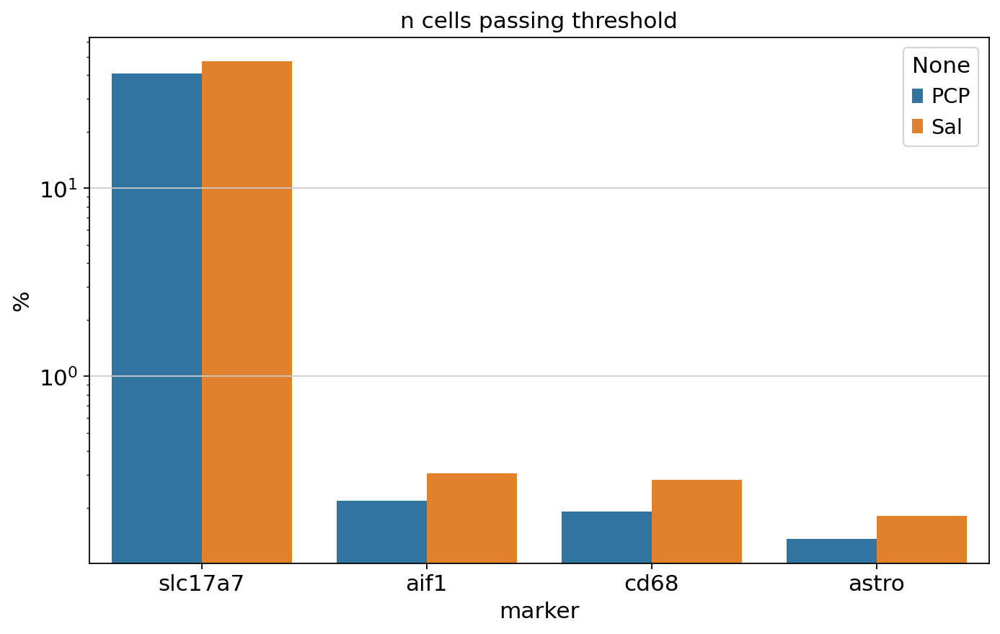

In [1054]:
sns.barplot(new_df, x = 'marker', y='%', hue = new_df.index)
plt.title('n cells passing threshold')
plt.yscale('log')
plt.show()

In [1055]:

# GABA vs glia
thresh_l = np.arange(0, 105, 5)

# Initialize lists to store results
results = {
    'gad1_gfap': [],
    'gad1_aldh1l1': [],
    'gad1_s100b': [],
    'gad1_mbp': [],
    'gad1_mog': [],
    'gad1_cnp': [],
    'gad1_aif1': [],
    'gad1_cd68': [],
    'gad1_astro': [],
    'gad1_oli': [],
    'gad1_mi': []
}

for thresh in thresh_l:
    results['gad1_gfap'].append(sum((gad1 < thresh) & (gfap < thresh)))
    results['gad1_aldh1l1'].append(sum((gad1 < thresh) & (aldh1l1 < thresh)))
    results['gad1_s100b'].append(sum((gad1 < thresh) & (s100b < thresh)))
    results['gad1_mbp'].append(sum((gad1 < thresh) & (mbp < thresh)))
    results['gad1_mog'].append(sum((gad1 < thresh) & (mog < thresh)))
    results['gad1_cnp'].append(sum((gad1 < thresh) & (cnp < thresh)))
    results['gad1_aif1'].append(sum((gad1 < thresh) & (aif1 < thresh)))
    results['gad1_cd68'].append(sum((gad1 < thresh) & (cd68 < thresh)))
    
    results['gad1_astro'].append(sum((gad1 < thresh) & (gfap < thresh) & (aldh1l1 < thresh) & (s100b < thresh)))
    results['gad1_oli'].append(sum((gad1 < thresh) & (mbp < thresh) & (mog < thresh) & (cnp < thresh)))
    results['gad1_mi'].append(sum((gad1 < thresh) & (aif1 < thresh) & (cd68 < thresh)))


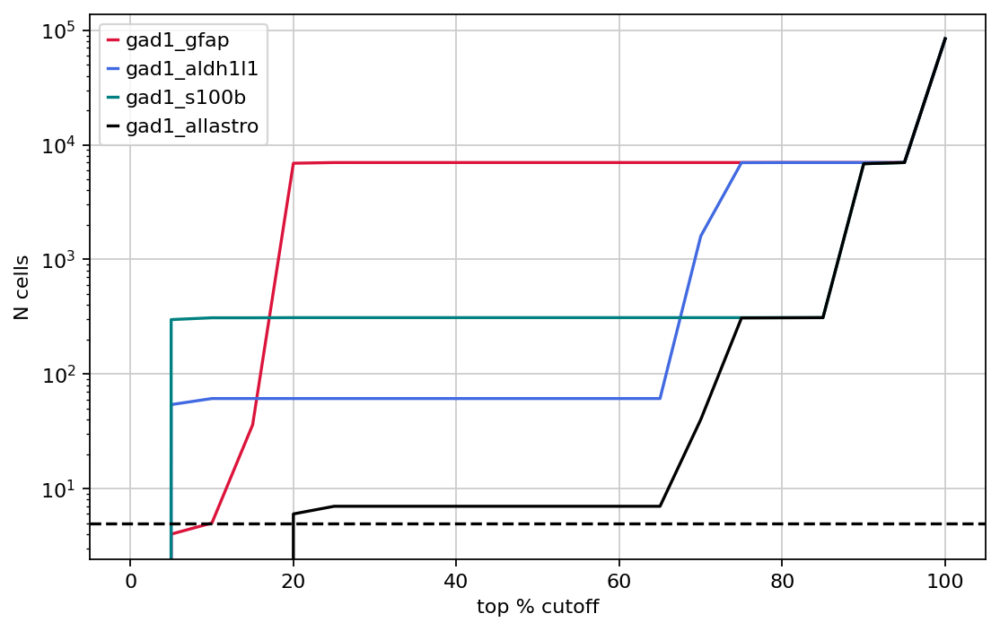

In [1056]:
#GABA vs astro
from matplotlib import pyplot as plt

from matplotlib import pyplot as plt

# Plot N cells expressing cell type markers with increasing cutoff
fig, ax = plt.subplots(figsize=(8, 5))
plt.plot(thresh_l, results['gad1_gfap'], label='gad1_gfap', c='crimson')
plt.plot(thresh_l, results['gad1_aldh1l1'], label='gad1_aldh1l1', c='royalblue')
plt.plot(thresh_l, results['gad1_s100b'], label='gad1_s100b', c='teal')
plt.plot(thresh_l, results['gad1_astro'], label='gad1_allastro', c='k')

# plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
plt.show()


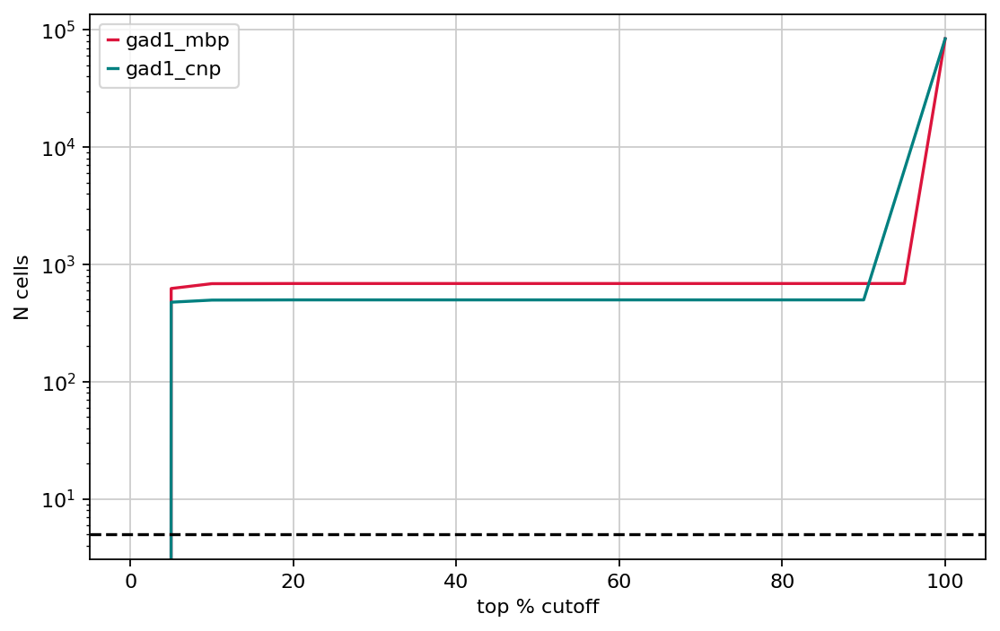

In [1057]:
from matplotlib import pyplot as plt

# Plot N cells expressing cell type markers with increasing cutoff
fig, ax = plt.subplots(figsize=(8, 5))
plt.plot(thresh_l, results['gad1_mbp'], label='gad1_mbp', c='crimson')
plt.plot(thresh_l, results['gad1_mog'], label='gad1_mog', c='royalblue')
plt.plot(thresh_l, results['gad1_cnp'], label='gad1_cnp', c='teal')
plt.plot(thresh_l, results['gad1_oli'], label='gad1_alloli', c='k')

# plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
# plt.savefig('prac.svg')
plt.show()


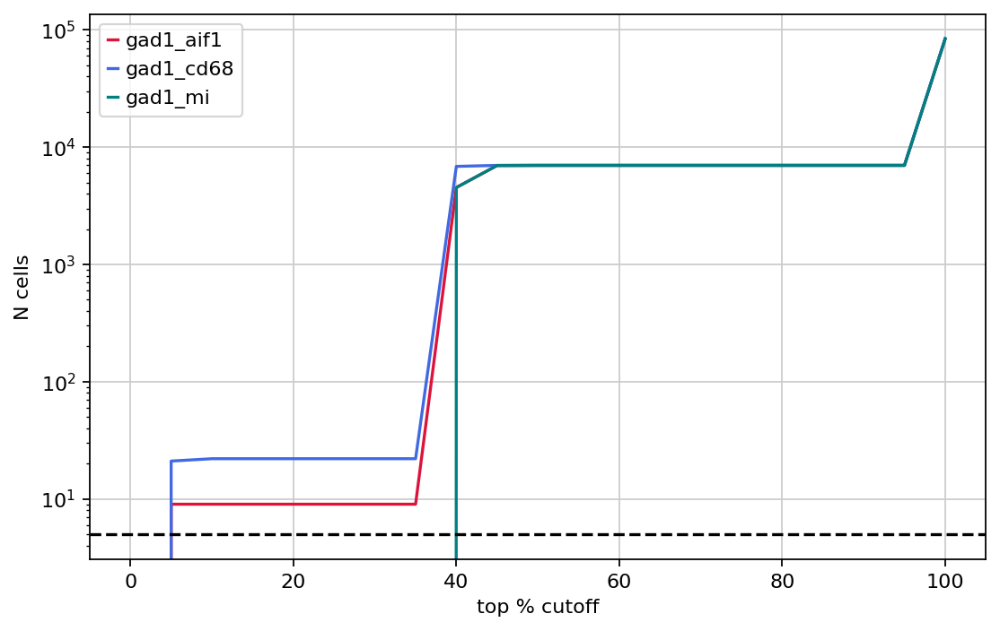

In [1058]:
from matplotlib import pyplot as plt

# Plot N cells expressing cell type markers with increasing cutoff
fig, ax = plt.subplots(figsize=(8, 5))
plt.plot(thresh_l, results['gad1_aif1'], label='gad1_aif1', c='crimson')
plt.plot(thresh_l, results['gad1_cd68'], label='gad1_cd68', c='royalblue')
plt.plot(thresh_l, results['gad1_mi'], label='gad1_mi', c='teal')

# plt.xscale('log')
plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('top % cutoff', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
plt.axhline(len(data_l), linestyle='--', c='k')
# plt.savefig('prac.svg')
plt.show()


In [1059]:
#GABA vs glia
thresh = 20

#PCP vs saline
gad1_aif1 = (gad1 < thresh) & (aif1<thresh)
gad1_cd68 = (gad1 < thresh) & (cd68<thresh)
gad1_mbp = (gad1 < thresh) & (mbp<thresh)
gad1_cnp = (gad1 < thresh) & (cnp<thresh)
gad1_aldh1l1 = (gad1 < thresh) & (aldh1l1<thresh)
gad1_s100b = (gad1 < thresh) & (s100b<thresh)

new_df = pd.DataFrame()
new_df = pd.concat([new_df, subdata[gad1_aif1].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df, subdata[gad1_cd68].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df, subdata[gad1_mbp].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df, subdata[gad1_cnp].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df, subdata[gad1_aldh1l1].obs.groupby('condition').count()['LibID']])
new_df = pd.concat([new_df, subdata[gad1_s100b].obs.groupby('condition').count()['LibID']])
new_df.rename(columns={'LibID': 'counts'}, inplace=True)
new_df['%'] = (new_df['counts'] / np.tile(subdata.obs.groupby('condition').count()['LibID'].values, 6)) * 100
new_df['split'] = [
    'gad1_aif1', 'gad1_aif1',
    'gad1_cd68', 'gad1_cd68',
    'gad1_mbp', 'gad1_mbp',
    'gad1_cnp', 'gad1_cnp',
    'gad1_aldh1l1', 'gad1_aldh1l1',
    'gad1_s100b', 'gad1_s100b'
]



/tmp/ipykernel_3437533/2355072386.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  new_df = pd.concat([new_df, subdata[gad1_aif1].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/2355072386.py:13: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  new_df = pd.concat([new_df, subdata[gad1_aif1].obs.groupby('condition').count()['LibID']])
/tmp/ipykernel_3437533/2355072386.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt 

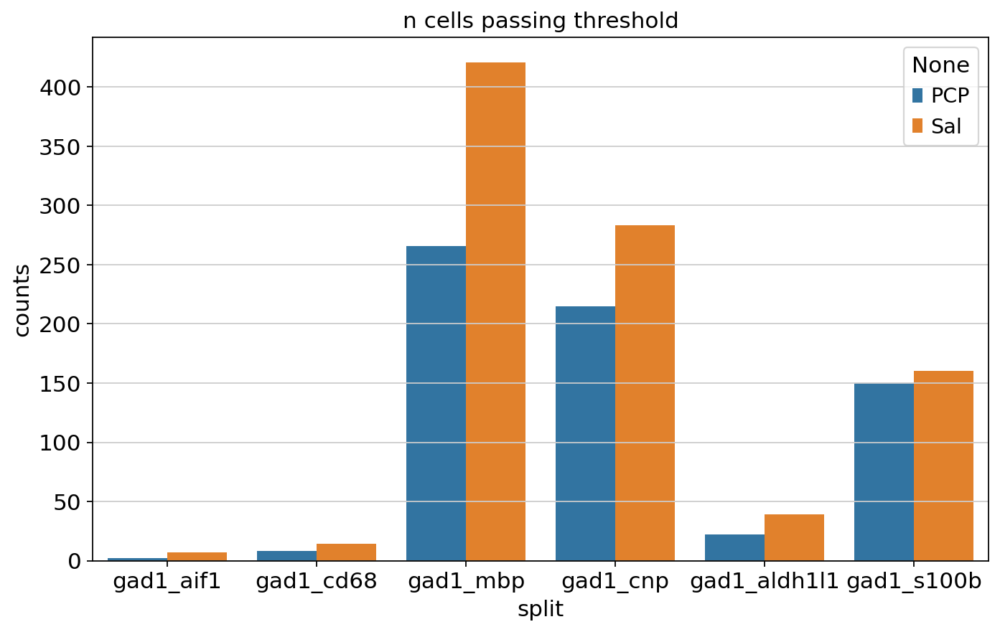

In [1060]:
sns.barplot(new_df, x = 'split', y='counts', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()

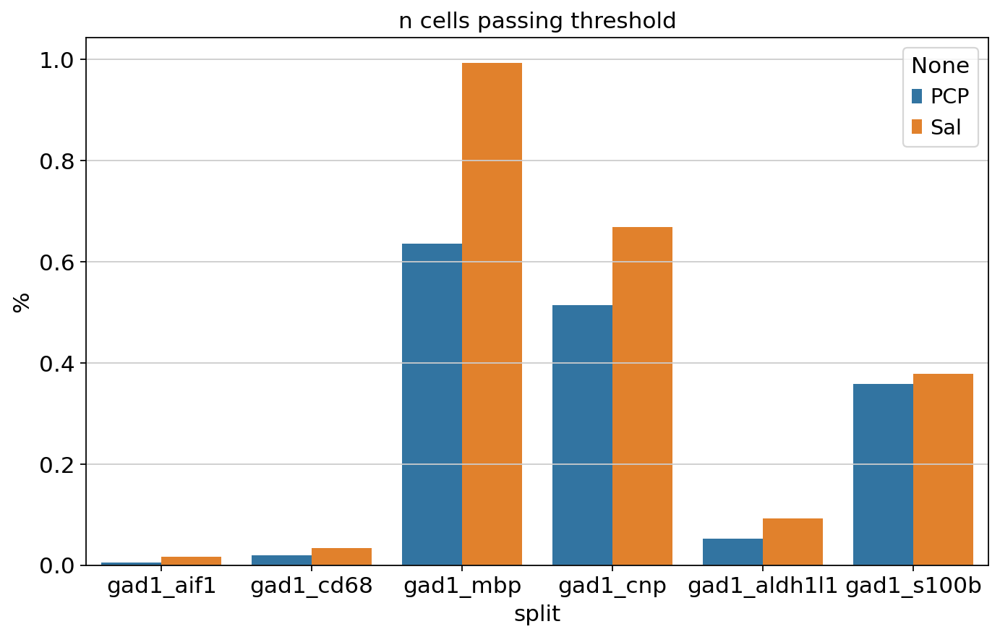

In [1061]:
sns.barplot(new_df, x = 'split', y='%', hue = new_df.index)
plt.title('n cells passing threshold')
plt.show()